In [122]:
import palantir
import dynchro
import scanpy as sc
import numpy as np
import anndata as ad
import pandas as pd
import seaborn as sns

from matplotlib import pyplot as plt


# 1. Read in data

In [27]:


import scanpy as sc

# Read in the data, with backup URLs provided
adata_Rep1 = sc.read(
    "../data/human_cd34_bm_rep1.h5ad",
    backup_url="https://s3.amazonaws.com/dp-lab-data-public/palantir/human_cd34_bm_rep1.h5ad",
)
adata_Rep2 = sc.read(
    "../data/human_cd34_bm_rep2.h5ad",
    backup_url="https://s3.amazonaws.com/dp-lab-data-public/palantir/human_cd34_bm_rep2.h5ad",
)
adata_Rep3 = sc.read(
    "../data/human_cd34_bm_rep3.h5ad",
    backup_url="https://s3.amazonaws.com/dp-lab-data-public/palantir/human_cd34_bm_rep3.h5ad",
)



In [28]:
adata_Rep1.obsm["X_tsne"] = adata_Rep1.obsm["tsne"]
adata_Rep2.obsm["X_tsne"] = adata_Rep2.obsm["tsne"]
adata_Rep3.obsm["X_tsne"] = adata_Rep3.obsm["tsne"]

In [29]:
adata_Rep1, adata_Rep2, adata_Rep3

(AnnData object with n_obs × n_vars = 5780 × 14651
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential'
     uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types'
     obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_tsne',
 AnnData object with n_obs × n_vars = 6501 × 14913
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential'
     uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types'
     obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_tsne',
 AnnData object with n_obs × n_vars = 12046 × 14044
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential'
     uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types'
     obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_tsne')

## 1.1 Determine branches

In [89]:
def probabilities(adata):
    branches = adata.uns["palantir_branch_probs_cell_types"]
    all_probabilities = adata.obsm["palantir_branch_probs"]

    probabilities = {}

    for ix, branch in enumerate(branches):
        prob = all_probabilities[:, ix]

        value = [prob[i] if prob[i] == max(all_probabilities[i, :]) else 0 for i in range(len(prob))]
        probabilities[branch] = value

    return probabilities

def plot_branches(adata):
    probs = probabilities(adata)

    x = adata.obsm["X_tsne"][:, 0]
    y = adata.obsm["X_tsne"][:, 1]
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))

    for i, (key, value) in enumerate(probs.items()):
        ax = axs[i // 3, i % 3]
        ax.scatter(x, y, c=value, cmap="Reds", s=5)
        ax.set_title(key)

In [31]:
def add_mapping(mapping, model):
    rev_mapping = {}
    for k, v in mapping.items():
        for i in v:
            rev_mapping[i] = k

    model.obs["cell_type"] = [rev_mapping[int(i)] for i in model.obs["clusters"]]

In [32]:
mapping_Rep1 = {
    "Mono": [3, 6],
    "CLP": [5],
    "DC": [7],
    "HSC": [0, 1, 4],
    "Ery": [2, 8],
    "Mega": [9]
}

add_mapping(mapping_Rep1, adata_Rep1)

adata_Rep1.obs

,clusters,palantir_pseudotime,palantir_diff_potential,cell_type
index,,,,
Run4_120703408880541,2,0.528063,0.294430,Ery
Run4_120703409056541,0,0.071683,1.418632,HSC
Run4_120703409580963,3,0.748991,0.279959,Mono
Run4_120703423990708,3,0.712743,0.296824,Mono
Run4_120703424252854,4,0.514219,1.250914,HSC
...,...,...,...,...
Run5_241114589051630,8,0.803283,0.007726,Ery
Run5_241114589051819,1,0.386990,1.331768,HSC
Run5_241114589128940,4,0.451526,1.374819,HSC


/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


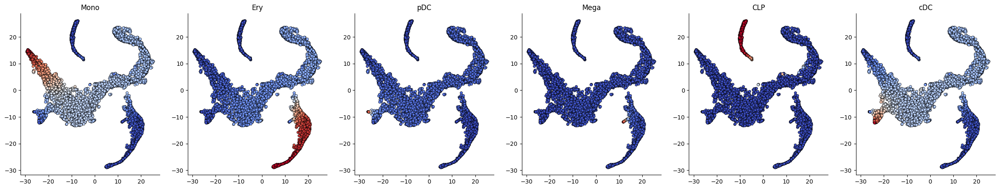

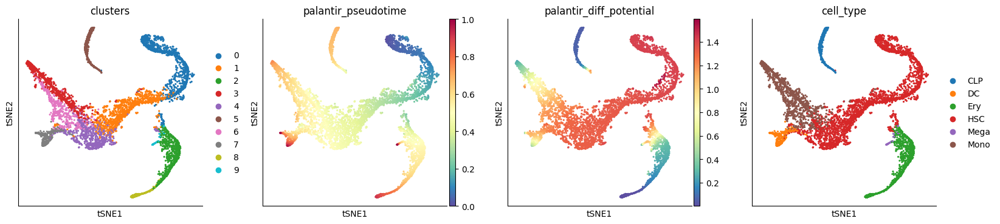

In [52]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(1, 6)
fig.set_size_inches(30, 5)

for i in range(6):
    title = adata_Rep1.uns["palantir_branch_probs_cell_types"][i]
    color = adata_Rep1.obsm["palantir_branch_probs"][:, i]
    x = adata_Rep1.obsm["X_tsne"][:, 0]
    y = adata_Rep1.obsm["X_tsne"][:, 1]
    axs[i].scatter(x, y, c=color, cmap="coolwarm", s = 20, linewidths = .5, edgecolors = "black")
    axs[i].set_title(title)

sc.pl.tsne(adata_Rep1, color=["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

plt.show()

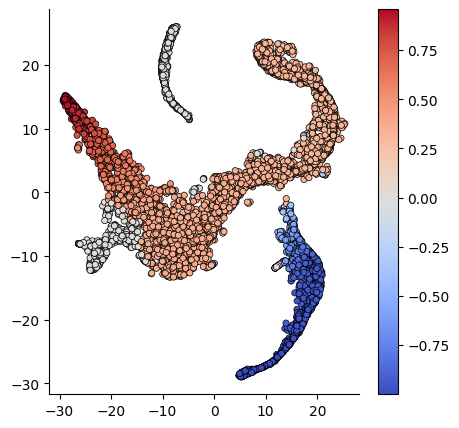

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


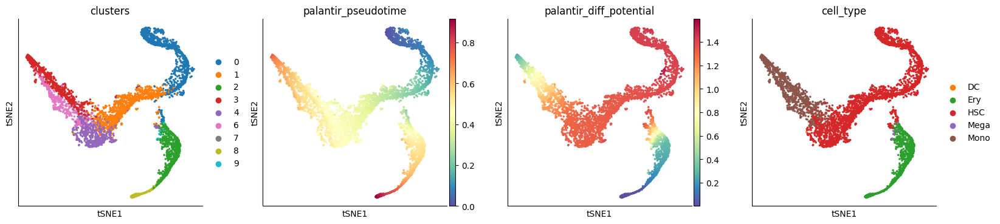

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


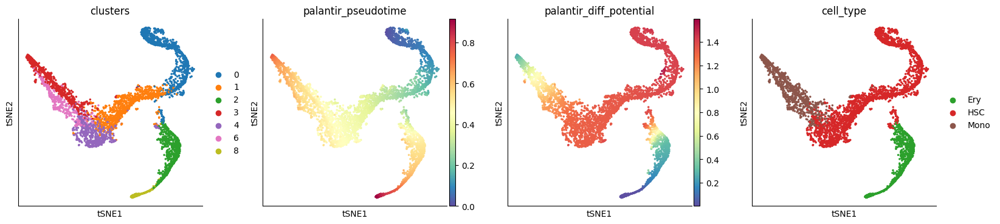

In [193]:
# disambiguate mono and ery and common cells
probs = probabilities(adata_Rep1)
monoprobs = probs["Mono"]
eryprobs = probs["Ery"]

diff = [monoprobs[i] - eryprobs[i] for i in range(len(monoprobs))]
x = adata_Rep1.obsm["X_tsne"][:, 0]
y = adata_Rep1.obsm["X_tsne"][:, 1]
# plot

plt.figure(figsize=(5, 5))
plt.scatter(x, y, c=diff, cmap="coolwarm", s = 20, linewidths = .5, edgecolors = "black")
plt.colorbar()
plt.show()

mask_mono = (np.array(monoprobs) > np.array(eryprobs) ) & ( np.array(monoprobs) > 0)
mask_ery = (np.array(eryprobs) > np.array(monoprobs) ) & ( np.array(eryprobs) > 0)
mask = mask_mono | mask_ery
mono_ery = adata_Rep1[mask]

sc.pl.tsne(mono_ery, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

# mono is 0, 1, 3, 4, 6
# ery is 0, 2, 8
mono_ery_Rep1 = mono_ery[mono_ery.obs["clusters"].isin(["0", "1", "2", "3", "4", "6", "8"])]
sc.pl.tsne(mono_ery_Rep1, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

mono_ery_Rep1.write_h5ad("rep1_mono_ery.h5ad")

In [114]:
t1 = np.array(monoprobs) > np.array(eryprobs) 

In [115]:
t2 = np.array(monoprobs) > 0

In [117]:
t1 & t2

array([False,  True,  True, ...,  True, False,  True])

In [118]:
(np.array(monoprobs) > np.array(eryprobs) ) & ( np.array(monoprobs) > 0)

array([False,  True,  True, ...,  True, False,  True])

In [34]:
mapping_Rep2 = {
    "Mono": [3, 4],
    "CLP": [7],
    "DC": [5, 8],
    "HSC": [0,1],
    "Ery": [2, 6],
    "Mega": [9]
}

add_mapping(mapping_Rep2, adata_Rep2)

adata_Rep2.obs

,clusters,palantir_pseudotime,palantir_diff_potential,cell_type
index,,,,
Run1_120703409151260,0,0.111099,1.554974,HSC
Run1_120703409665908,2,0.456458,0.765090,Ery
Run1_120703423794532,0,0.018614,1.582979,HSC
Run1_120703455541980,1,0.455399,1.543326,HSC
Run1_120726943062812,2,0.453506,0.597368,Ery
...,...,...,...,...
Run3_241106421238491,0,0.144553,1.580640,HSC
Run3_241106421476651,2,0.651538,0.319971,Ery
Run3_241106421500699,4,0.414507,1.218321,Mono


/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


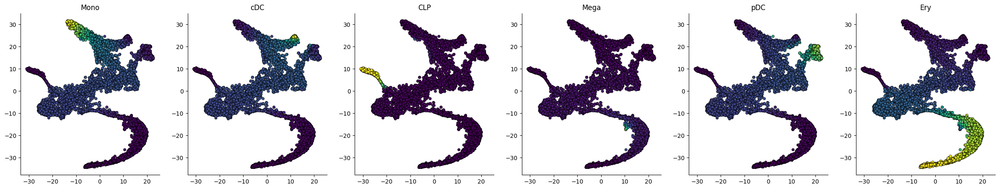

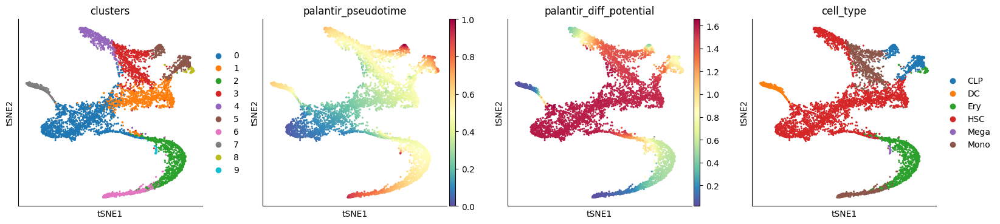

In [26]:
fig, axs = plt.subplots(1, 6)
fig.set_size_inches(30, 5)

for i in range(6):
    title = adata_Rep2.uns["palantir_branch_probs_cell_types"][i]
    color = adata_Rep2.obsm["palantir_branch_probs"][:, i]
    x = adata_Rep2.obsm["X_tsne"][:, 0]
    y = adata_Rep2.obsm["X_tsne"][:, 1]
    axs[i].scatter(x, y, c=color, cmap="viridis", s = 20, linewidths = .5, edgecolors = "black")
    axs[i].set_title(title)

sc.pl.tsne(adata_Rep2, color=["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

plt.show()

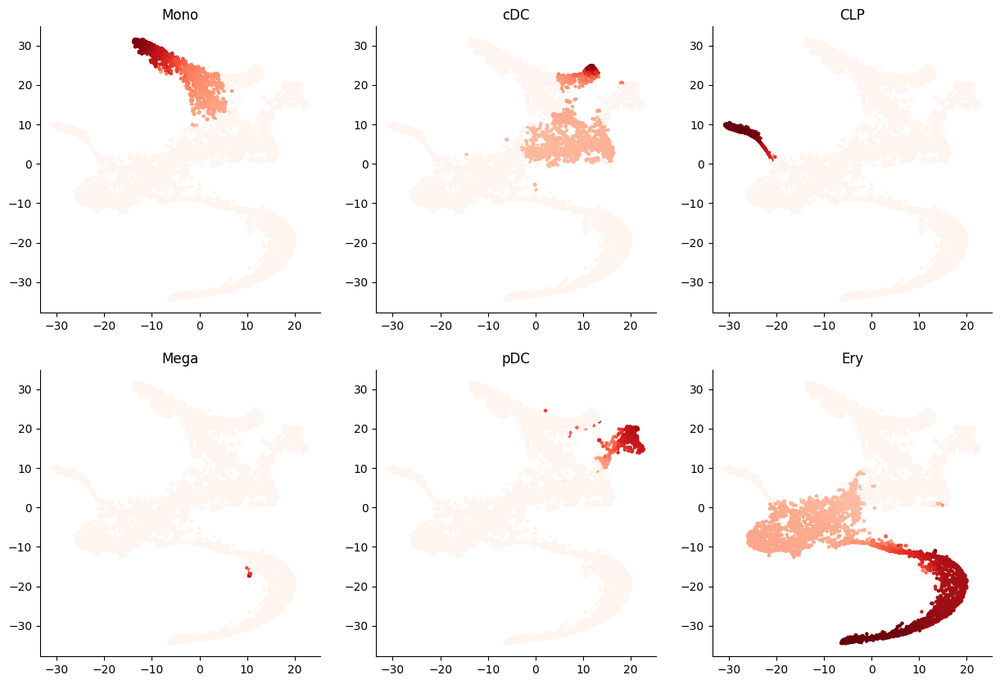

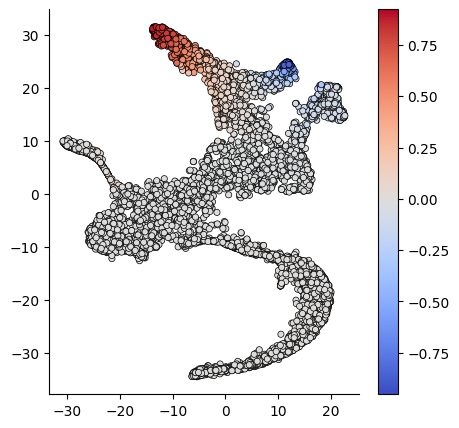

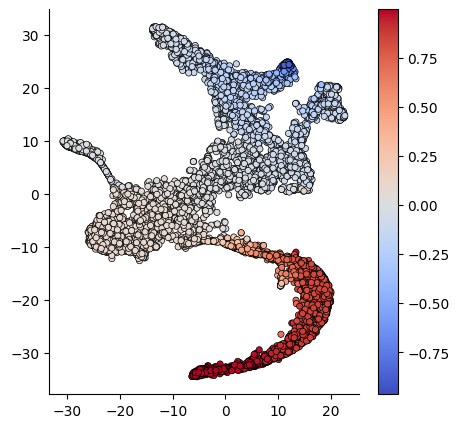

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


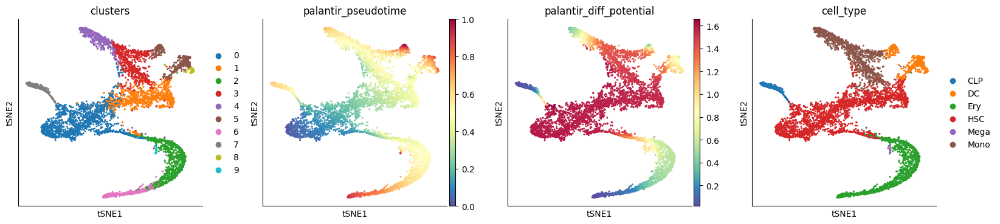

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


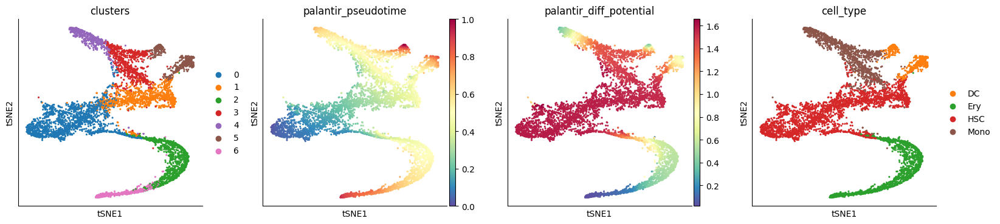

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


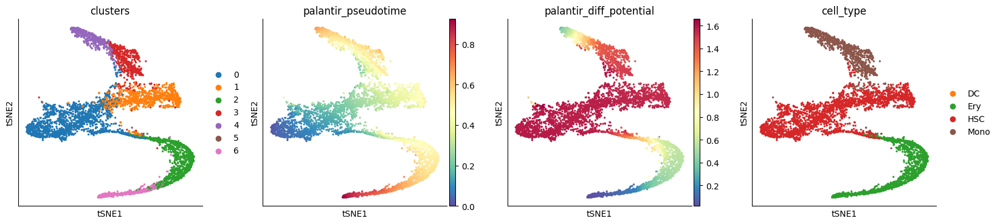

In [194]:
# disambiguate mono and ery and common cells in Rep2
plot_branches(adata_Rep2)
probs2 = probabilities(adata_Rep2)

monoprobs = adata_Rep2.obsm["palantir_branch_probs"][:, 0]
cDcprobs = adata_Rep2.obsm["palantir_branch_probs"][:, 1]
eryprobs = adata_Rep2.obsm["palantir_branch_probs"][:, 5]

x = adata_Rep2.obsm["X_tsne"][:, 0]
y = adata_Rep2.obsm["X_tsne"][:, 1]

mono_cdc = monoprobs - cDcprobs
ery_cdc = eryprobs - cDcprobs

# more mono
plt.figure(figsize=(5, 5))
plt.scatter(x, y, c=mono_cdc, cmap="coolwarm", s = 20, linewidths = .5, edgecolors = "black")
plt.colorbar()
plt.show()

# more ery
plt.figure(figsize=(5, 5))
plt.scatter(x, y, c=ery_cdc, cmap="coolwarm", s = 20, linewidths = .5, edgecolors = "black")
plt.colorbar()
plt.show()

sc.pl.tsne(adata_Rep2, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

# select the mono, cdc and ery cells, and then have an error margin for the common ones
keep = ["4", "3", "1", "5", "0", "2", "6"]
mono_ery_cdc = adata_Rep2[adata_Rep2.obs["clusters"].isin(keep)]

sc.pl.tsne(mono_ery_cdc, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])


monoprobs = mono_ery_cdc.obsm["palantir_branch_probs"][:, 0]
cDcprobs = mono_ery_cdc.obsm["palantir_branch_probs"][:, 1]
eryprobs = mono_ery_cdc.obsm["palantir_branch_probs"][:, 5]

probs2 = probabilities(mono_ery_cdc)
pDcprobs = probs2["pDC"]

mono_cdc = monoprobs - cDcprobs
ery_cdc = eryprobs - cDcprobs

mask_mono = (np.array(monoprobs) > np.array(cDcprobs) ) & ( np.array(monoprobs) > 0)
mask_ery = (np.array(eryprobs) > np.array(cDcprobs) ) & ( np.array(eryprobs) > 0)
mask_pdc = (np.array(pDcprobs) > 0)

maks_rest = (mono_cdc > -0.1) & (ery_cdc > -0.1) 
mask = (mask_mono | mask_ery | maks_rest)
mask = mask & ~mask_pdc

final_mono_ery_rep2 = mono_ery_cdc[mask]

sc.pl.tsne(final_mono_ery_rep2, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])

final_mono_ery_rep2.write_h5ad("rep2_mono_ery.h5ad")


In [36]:
mapping_Rep3 = {
    "Mono": [3,7],
    "CLP": [0],
    "DC": [9,4],
    "HSC": [2,1,6],
    "Ery": [5],
    "Mega": [8]
}

add_mapping(mapping_Rep3, adata_Rep3)

adata_Rep3.obs

,clusters,palantir_pseudotime,palantir_diff_potential,cell_type
index,,,,
Run1_120703409605350,6,0.376909,1.395921,HSC
Run1_120703423995174,0,0.496634,0.164828,CLP
Run1_120726896982380,0,0.531917,0.125505,CLP
Run1_120726897485621,4,0.610955,1.153430,DC
Run1_120726912350059,2,0.078194,1.712830,HSC
...,...,...,...,...
Run4_241114589845732,2,0.035205,1.735317,HSC
Run4_241114589915956,4,0.688505,0.811938,DC
Run4_241114607996339,2,0.198628,1.648749,HSC


/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


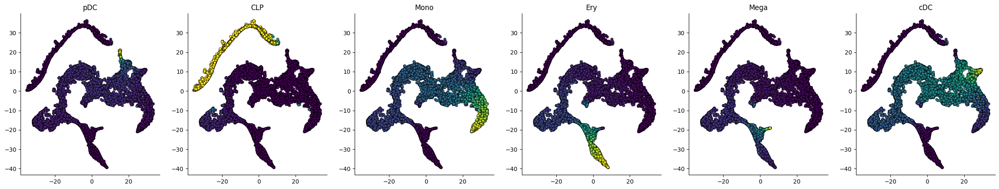

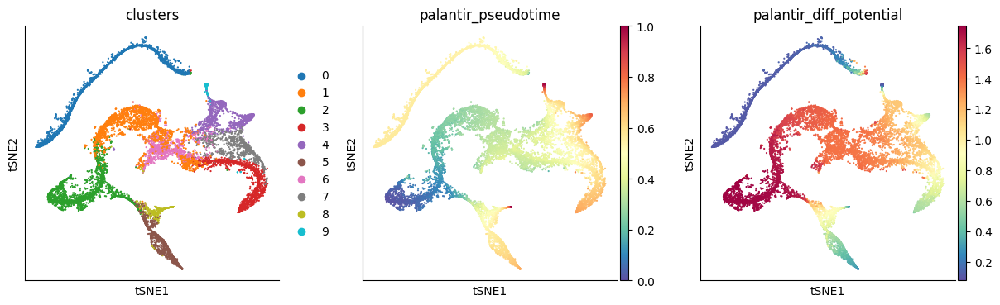

In [37]:
fig, axs = plt.subplots(1, 6)
fig.set_size_inches(30, 5)

for i in range(6):
    title = adata_Rep3.uns["palantir_branch_probs_cell_types"][i]
    color = adata_Rep3.obsm["palantir_branch_probs"][:, i]
    x = adata_Rep3.obsm["X_tsne"][:, 0]
    y = adata_Rep3.obsm["X_tsne"][:, 1]
    axs[i].scatter(x, y, c=color, cmap="viridis", s = 20, linewidths = .5, edgecolors = "black")
    axs[i].set_title(title)

sc.pl.tsne(adata_Rep3, color=["clusters", "palantir_pseudotime", "palantir_diff_potential"])
plt.show()

In [173]:
final_mono_Rep3, adata_Rep3

(AnnData object with n_obs × n_vars = 11070 × 14044
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type'
     uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types', 'clusters_colors', 'cell_type_colors'
     obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_tsne',
 AnnData object with n_obs × n_vars = 12046 × 14044
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type'
     uns: 'cluster_colors', 'ct_colors', 'palantir_branch_probs_cell_types', 'clusters_colors'
     obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_tsne')

In [186]:
~((clpprobs > 0) | (pdcprobs > 0) | (megaprobs > 0))

array([ True, False, False, ...,  True,  True,  True])

In [184]:
clpprobs.dtype, pdcprobs.dtype, megaprobs.dtype

(dtype('float64'), dtype('float64'), dtype('float64'))

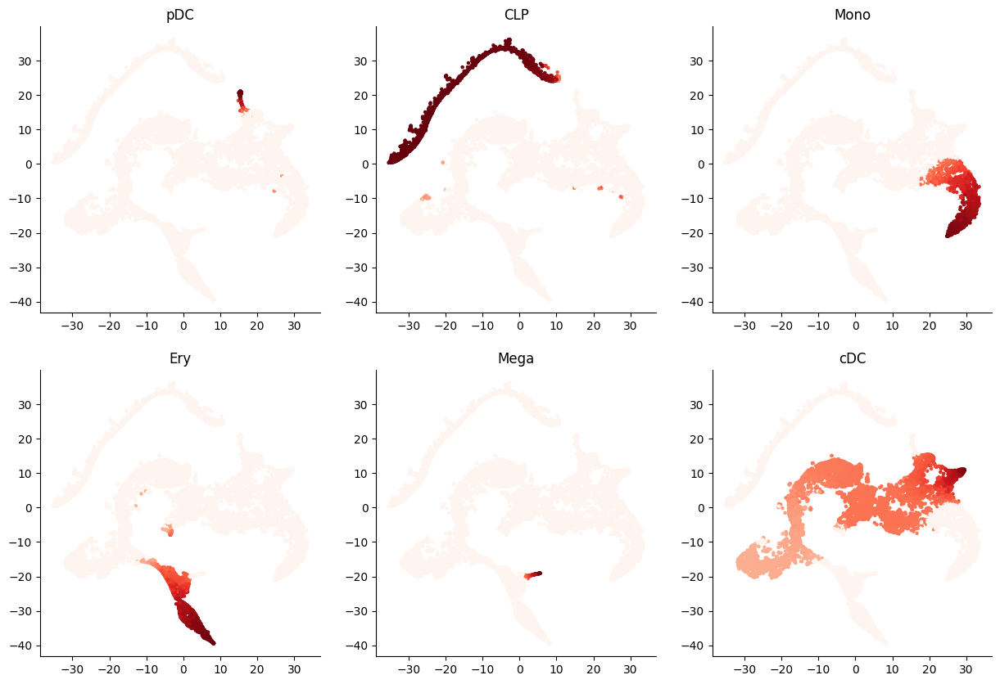

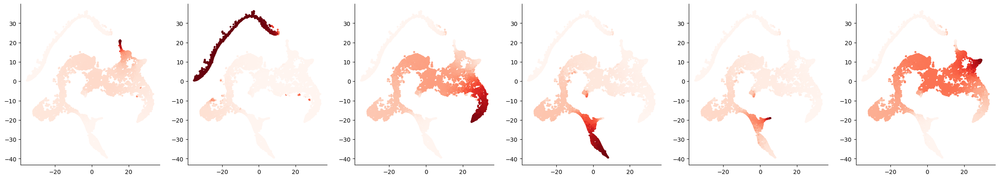

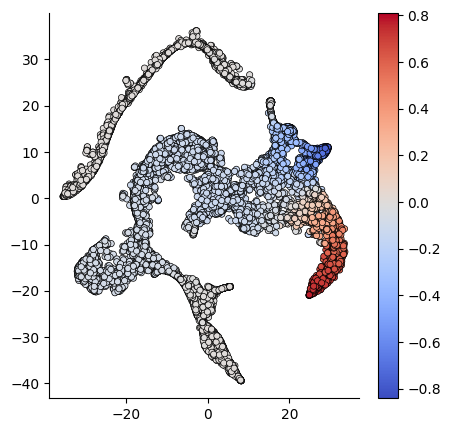

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


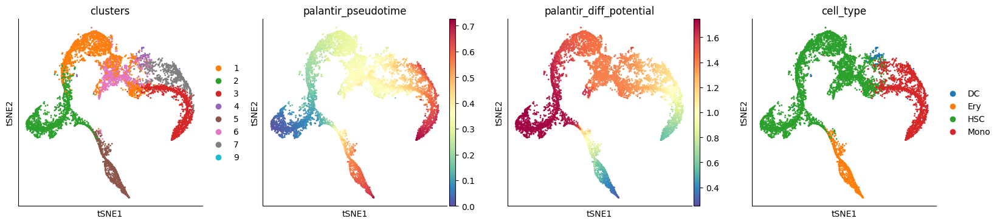

In [195]:
# disambiguate mono and ery and common cells in Rep2
plot_branches(adata_Rep3)
probs3 = probabilities(adata_Rep3)

fig, axs = plt.subplots(1, 6)
fig.set_size_inches(30, 5)

probs = adata_Rep3.obsm["palantir_branch_probs"]
for i in range(probs.shape[1]):
    tovis = probs[:, i]
    x = adata_Rep3.obsm["X_tsne"][:, 0]
    y = adata_Rep3.obsm["X_tsne"][:, 1]
    axs[i].scatter(x, y, c=tovis, cmap="Reds", s = 5)

# ery branch is just the ery things
# mono branch also has the cdc problem, so check the difference between mono and cdc

monoprobs = adata_Rep3.obsm["palantir_branch_probs"][:, 2]
cDcprobs = adata_Rep3.obsm["palantir_branch_probs"][:, 5]
eryprobs = np.array(probs3["Ery"]) #adata_Rep3.obsm["palantir_branch_probs"][:, 3]
pdcprobs = np.array(probs3["pDC"])
clpprobs = np.array(probs3["CLP"])
megaprobs = np.array(probs3["Mega"])

mono_cdc = monoprobs - cDcprobs

x = adata_Rep3.obsm["X_tsne"][:, 0]
y = adata_Rep3.obsm["X_tsne"][:, 1]

plt.figure(figsize=(5, 5))
plt.scatter(x, y, c=mono_cdc, cmap="coolwarm", s = 20, linewidths = .5, edgecolors = "black")
plt.colorbar()
plt.show()

mask = ((mono_cdc > -0.2) | (eryprobs > 0)) & ~((clpprobs > 0) | (pdcprobs > 0) | (megaprobs > 0))  # (monoprobs > 0)
final_mono_Rep3 = adata_Rep3[mask]
# remove mega
final_mono_Rep3 = final_mono_Rep3[final_mono_Rep3.obs["clusters"] != "8"]

# only keep relevant clusters
keep = ["2", "1", "6", "7", "9", "5", "1", "6"]

sc.pl.tsne(final_mono_Rep3, color = ["clusters", "palantir_pseudotime", "palantir_diff_potential", "cell_type"])
final_mono_Rep3.write_h5ad("rep3_mono_ery.h5ad")


## 1.2 split branches

In [95]:
rep1 = ad.read_h5ad("rep1_mono_ery.h5ad")
rep2 = ad.read_h5ad("rep2_mono_ery.h5ad")
rep3 = ad.read_h5ad("rep3_mono_ery.h5ad")

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


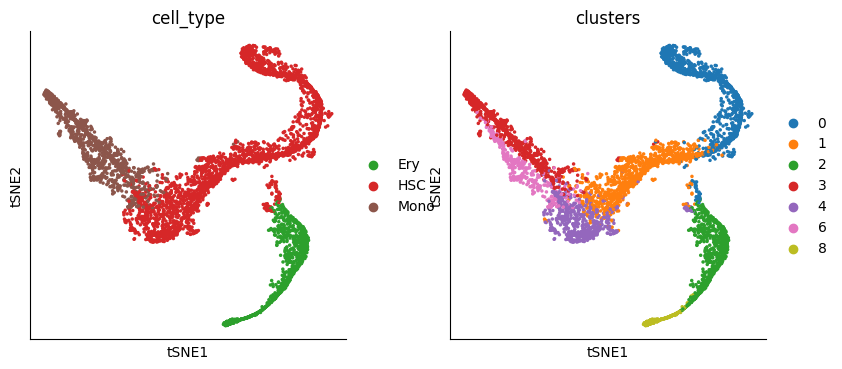

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


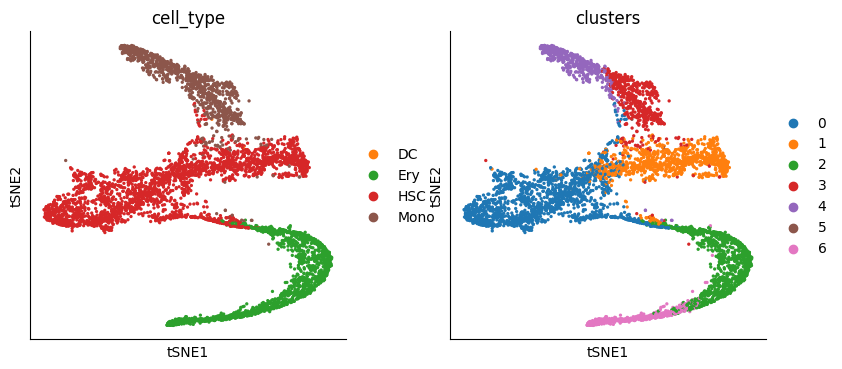

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


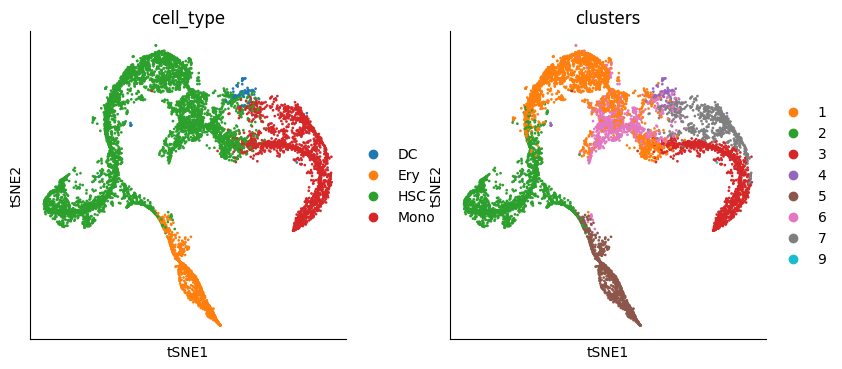

In [65]:
sc.pl.tsne(rep1, color = ["cell_type", "clusters"])
sc.pl.tsne(rep2, color = ["cell_type", "clusters"])
sc.pl.tsne(rep3, color = ["cell_type", "clusters"])

In [66]:
# prep, label lineages
rep1.uns["id"] = f"Mono & Ery branch, Rep1"
rep2.uns["id"] = f"Mono & Ery branch, Rep2"
rep3.uns["id"] = f"Mono & Ery branch, Rep3"

In [67]:
def label_lineages(adata, lineage_name, lineage_clusters):
    adata.obs["milestones"] = adata.obs["clusters"]
    adata.obs["pseudotime"] = adata.obs["palantir_pseudotime"]
    adata.uns["lineage_labels"] = []

    dynchro.pp.label_lineage(adata, "milestones", lineage_clusters, lineage_name)
    dynchro.pp.calculate_pseudocells(adata, 100, lineage_name)
    return adata

def split_dataset(adata, keep):
    acopy = adata.copy()
    acopy = acopy[acopy.obs["clusters"].isin(keep)]
    return acopy

/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["clusters"]
/home/louise/Work/dynchro/src/dynchro/pp/pseudocells.py:53: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"transition_matrix_{amount}"] = np.array(
/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["clusters"]
/home/louise/Work/dynchro/src/dynchro/pp/pseudocells.py:53: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"transition_matrix_{amount}"] = np.array(
/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["cluster

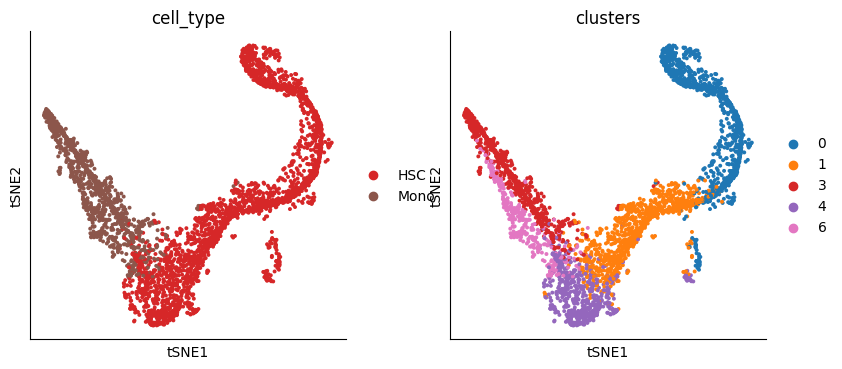

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


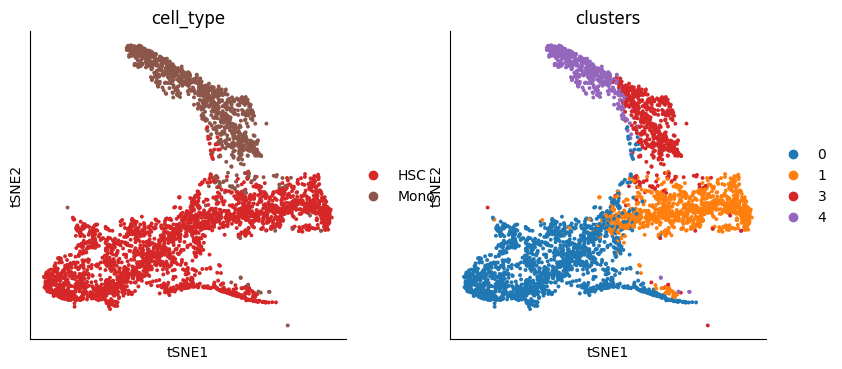

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


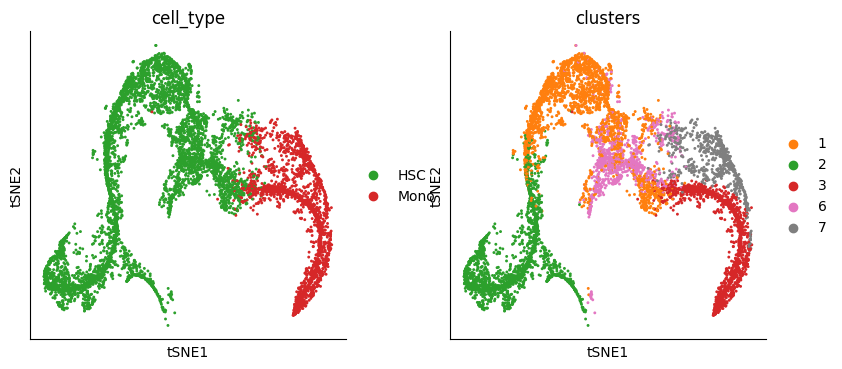

In [68]:
rep1_mono_clusters = ["0", "1", "3", "4", "6"]
rep2_mono_clusters = ["0", "1", "3", "4"]
rep3_mono_clusters = ['2', '1', '6', '7', '3']

rep1_mono = split_dataset(rep1, rep1_mono_clusters)
rep1_mono = label_lineages(rep1_mono, "Mono", rep1_mono_clusters)
rep1_mono.uns["id"] = "Mono branch, Rep1"

rep2_mono = split_dataset(rep2, rep2_mono_clusters)
rep2_mono = label_lineages(rep2_mono, "Mono", rep2_mono_clusters)
rep2_mono.uns["id"] = "Mono branch, Rep2"

rep3_mono = split_dataset(rep3, rep3_mono_clusters)
rep3_mono = label_lineages(rep3_mono, "Mono", rep3_mono_clusters)
rep3_mono.uns["id"] = "Mono branch, Rep3"

sc.pl.tsne(rep1_mono, color = ["cell_type", "clusters"])
sc.pl.tsne(rep2_mono, color = ["cell_type", "clusters"])
sc.pl.tsne(rep3_mono, color = ["cell_type", "clusters"])

/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["clusters"]
/home/louise/Work/dynchro/src/dynchro/pp/pseudocells.py:53: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"transition_matrix_{amount}"] = np.array(
/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["clusters"]
/home/louise/Work/dynchro/src/dynchro/pp/pseudocells.py:53: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[f"transition_matrix_{amount}"] = np.array(
/tmp/ipykernel_580329/1776331841.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["milestones"] = adata.obs["cluster

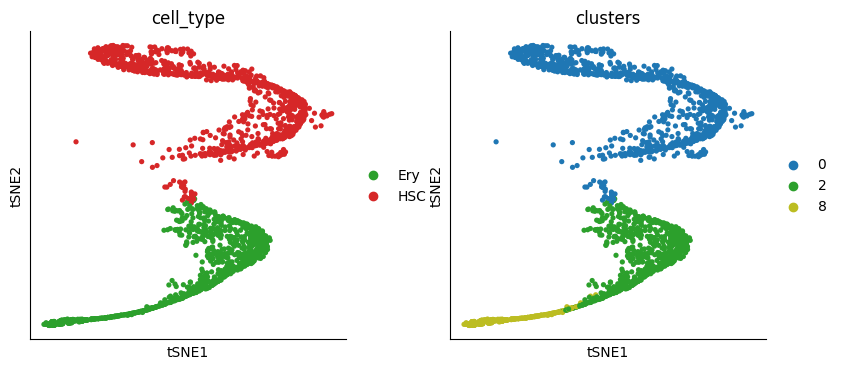

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


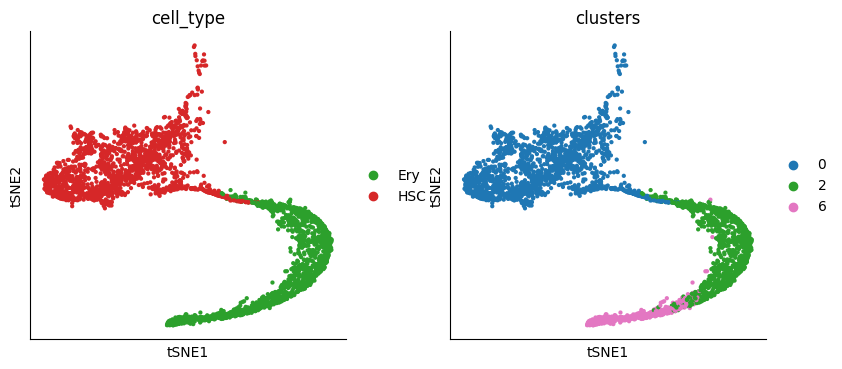

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


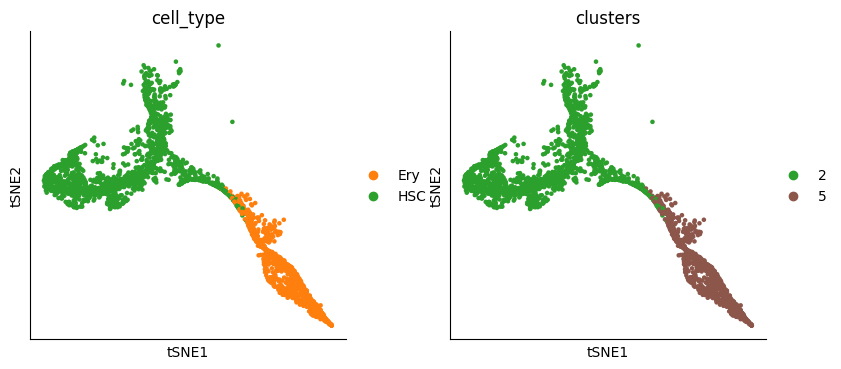

In [69]:
rep1_ery_clusters = ["0", "2", "8"]
rep2_ery_clusters = ["0", "2", "6"]
rep3_ery_clusters = ["2", "5"]

rep1_ery = split_dataset(rep1, rep1_ery_clusters)
rep1_ery = label_lineages(rep1_ery, "Ery", rep1_ery_clusters)
rep1_ery.uns["id"] = "Ery branch, Rep1"

rep2_ery = split_dataset(rep2, rep2_ery_clusters)
rep2_ery = label_lineages(rep2_ery, "Ery", rep2_ery_clusters)
rep2_ery.uns["id"] = "Ery branch, Rep2"

rep3_ery = split_dataset(rep3, rep3_ery_clusters)
rep3_ery = label_lineages(rep3_ery, "Ery", rep3_ery_clusters)
rep3_ery.uns["id"] = "Ery branch, Rep3"

sc.pl.tsne(rep1_ery, color = ["cell_type", "clusters"])
sc.pl.tsne(rep2_ery, color = ["cell_type", "clusters"])
sc.pl.tsne(rep3_ery, color = ["cell_type", "clusters"])

In [70]:
def write_with_pc(adata, name):

    for pckey in adata.uns["pseudocells"]:
        if f"{pckey}_pseudotime_index" not in adata.uns:
            pseudocells = adata.uns[f"{pckey}_pseudotime"]
            pseudocells_index = pseudocells.index.values
            pseudocells_values = pseudocells.values

            adata.uns[f"{pckey}_pseudotime_index"] = pseudocells_index
            adata.uns[f"{pckey}_pseudotime_values"] = pseudocells_values

            adata.uns[f"{pckey}_pseudotime"] = "removed"

    adata.write_h5ad(f"{name}.h5ad")

In [71]:
def read_with_pc(file):
    adata = ad.read_h5ad(file)

    for pckey in adata.uns["pseudocells"]:
        if adata.uns[f"{pckey}_pseudotime"] == "removed":
            pseudocells_index = adata.uns[f"{pckey}_pseudotime_index"]
            pseudocells_values = adata.uns[f"{pckey}_pseudotime_values"]

            pseudocells = pd.Series(pseudocells_values, index=pseudocells_index)
            adata.uns[f"{pckey}_pseudotime"] = pseudocells

    return adata

In [76]:
write_with_pc(rep1_mono, "rep1_mono")
write_with_pc(rep2_mono, "rep2_mono")
write_with_pc(rep3_mono, "rep3_mono")

write_with_pc(rep1_ery, "rep1_ery")
write_with_pc(rep2_ery, "rep2_ery")
write_with_pc(rep3_ery, "rep3_ery")

# 2. dynchro

## 2.1 dynchro prep functions

In [77]:
def get_config(trajectories, sort = True):
    config = {
        "compare_lineages_pseudocells": False,
        "compare_lineages_pseudocells_label": "pseudocells_50",
        "compare_trajectories_pseudocells": False,
        "compare_trajectories_pseudocells_label": "pseudocells_50",
        "align_pseudocells": False,
    }


    common_vars = list(set.intersection(*(set(trajectory.var_names) for trajectory in trajectories)))

    lineages = [
        [
            dynchro.tl.get_counts_common_vars(trajectory, config, "compare_trajectories_pseudocells", linlabel, common_vars, get_x = False)
            for linlabel in trajectory.uns["lineage_labels"]
        ]
        for trajectory in trajectories
    ]

    if sort:
        lineages = [[ lin[np.argsort(lin.obs.pseudotime)] for lin in lineages1 ] for lineages1 in lineages]

    return lineages

In [78]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_cost_distances(cost, distances, path1, path2):
    fig, (ax1, ax2) = plt.subplots(1,2)
    fig.set_size_inches(12, 4)
    sns.heatmap(cost, ax = ax1)
    distances = distances[1:, 1:]
    sns.heatmap(distances, ax = ax2)
    plt.scatter(path2, path1, c = "white", s = 3)
    plt.show()

In [126]:
class DTWResult:
    def __init__(self, lin1, lin2, cost, distances, path1, path2, dist, dist_norm, dist_norm_path):
        self._lin1 = lin1
        self._lin2 = lin2
        self._cost = cost
        self._distances = distances
        self._path1 = path1
        self._path2 = path2
        self._dist = dist
        self._dist_norm = dist_norm
        self._dist_norm_path = dist_norm_path

    def cost(self):
        return self._cost
    
    def distances(self):
        return self._distances

    def path1(self):
        return self._path1

    def path2(self):
        return self._path2
    
    def dist(self):
        return self._dist
    
    def dist_norm(self):
        return self._dist_norm
    
    def dist_norm_path(self):
        return self._dist_norm_path

    def get_warping(self):
        return self._path1, self._path2
    
    def plot_cost_distances(self):
        plot_cost_distances(self._cost, self._distances, self._path1, self._path2)

In [127]:
def dynchro_wrapper(ad1, ad2, distance_measure = "correlation"):
    trajectories = [ad1, ad2]
    lineages = get_config(trajectories)

    results = []

    for lineage1, label1 in zip(lineages[0], ad1.uns["lineage_labels"]):
        for lineage2, label2 in zip(lineages[1], ad2.uns["lineage_labels"]):
            print(lineage2.X.shape, lineage1.X.shape)
            lin1, lin2 = lineage1.X, lineage2.X
            total_dist, cost, distances = dynchro.tl.skip_dtw(lin1, lin2, distance = distance_measure)
            path1, path2 = dynchro.tl.skip_traceback(distances)

            total_dist_norm = total_dist / (lineage1.X.shape[0] + lineage2.X.shape[0])
            total_dist_norm2 = total_dist / len(path1)

            res = DTWResult(label1, label2, cost, distances, path1, path2, total_dist, total_dist_norm, total_dist_norm2)
            results.append(res)

            plot_cost_distances(cost, distances, path1, path2)

    return results

## 2.2 dynchro runs

In [80]:
rep1_mono = read_with_pc("rep1_mono.h5ad")
rep2_mono = read_with_pc("rep2_mono.h5ad")
rep3_mono = read_with_pc("rep3_mono.h5ad")

rep1_ery = read_with_pc("rep1_ery.h5ad")
rep2_ery = read_with_pc("rep2_ery.h5ad")
rep3_ery = read_with_pc("rep3_ery.h5ad")

mono = [rep1_mono, rep2_mono, rep3_mono]
ery = [rep1_ery, rep2_ery, rep3_ery]
rep1s = [rep1_mono, rep1_ery]
rep2s = [rep2_mono, rep2_ery]
rep3s = [rep3_mono, rep3_ery]

In [81]:
rep1_mono, rep2_mono, rep3_mono

(AnnData object with n_obs × n_vars = 3721 × 14651
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Mono'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Mono_pseudotime', 'pseudocells_100_Mono_pseudotime_index', 'pseudocells_100_Mono_pseudotime_values'
     obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'tsne'
     varm: 'pseudocells_100_Mono',
 AnnData object with n_obs × n_vars = 3794 × 14913
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Mono'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Mono_pseudotime', 'pseudocells_100_Mono_pseudotime_index', 'pseudocells_100_Mono_pseudotime_values'
    

In [82]:
rep1_ery, rep2_ery, rep3_ery

(AnnData object with n_obs × n_vars = 2113 × 14651
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Ery'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Ery_pseudotime', 'pseudocells_100_Ery_pseudotime_index', 'pseudocells_100_Ery_pseudotime_values'
     obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'tsne'
     varm: 'pseudocells_100_Ery',
 AnnData object with n_obs × n_vars = 3203 × 14913
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Ery'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Ery_pseudotime', 'pseudocells_100_Ery_pseudotime_index', 'pseudocells_100_Ery_pseudotime_values'
     obsm: 'M

0 0
(3721, 14651) (3721, 14651)


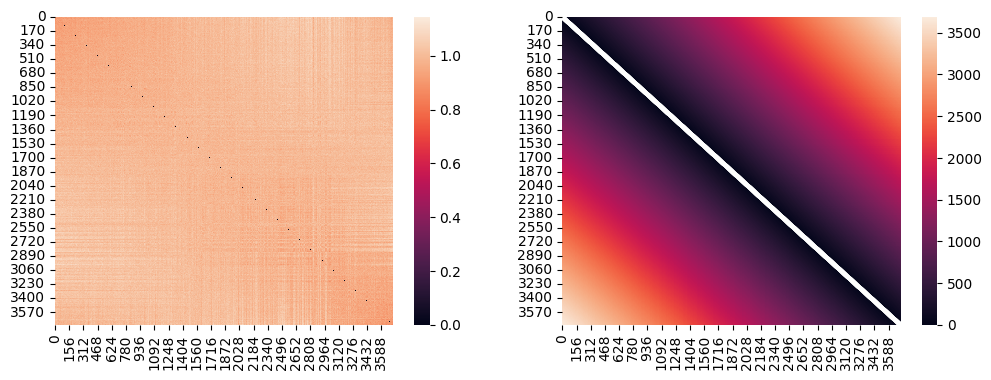

0 1
(3794, 14113) (3721, 14113)


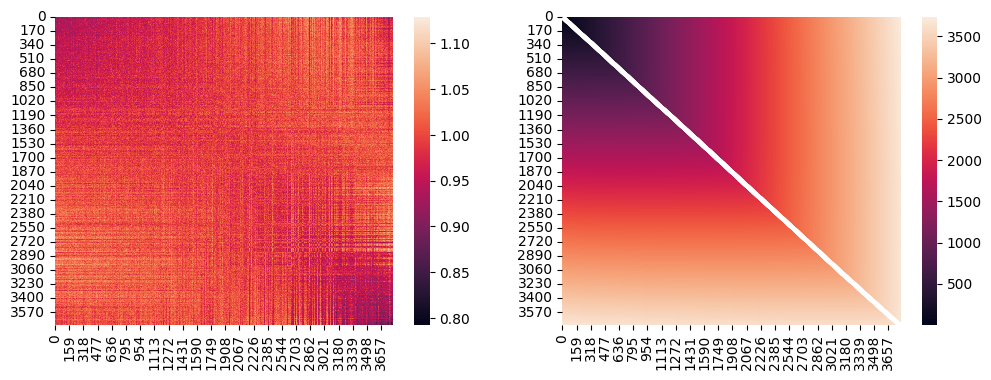

0 2
(6934, 13436) (3721, 13436)


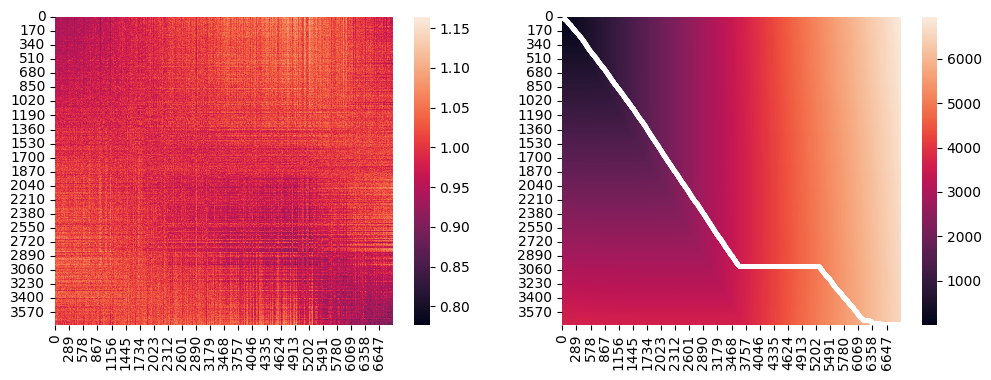

0 3
(2113, 14651) (3721, 14651)


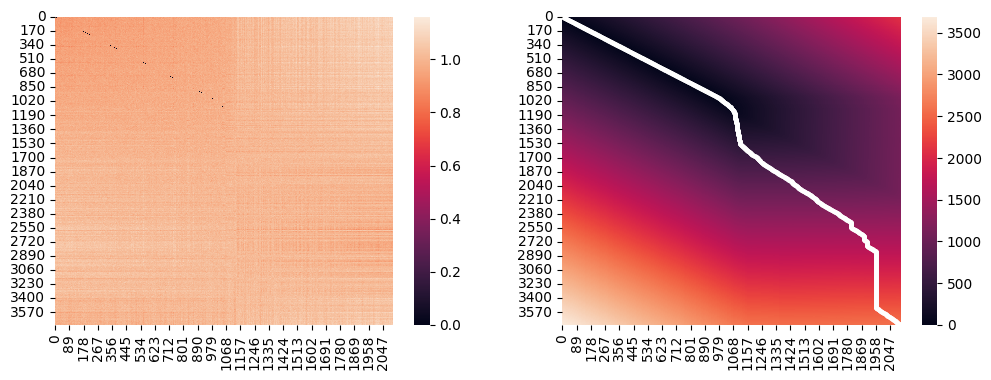

0 4
(3203, 14113) (3721, 14113)


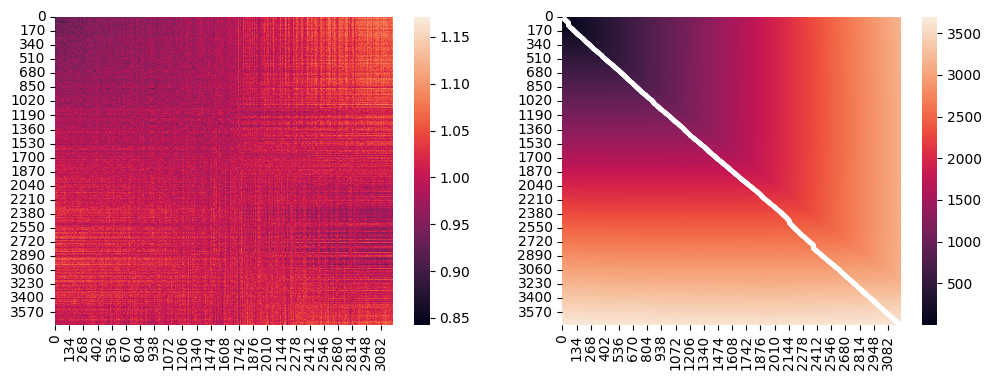

0 5
(2792, 13436) (3721, 13436)


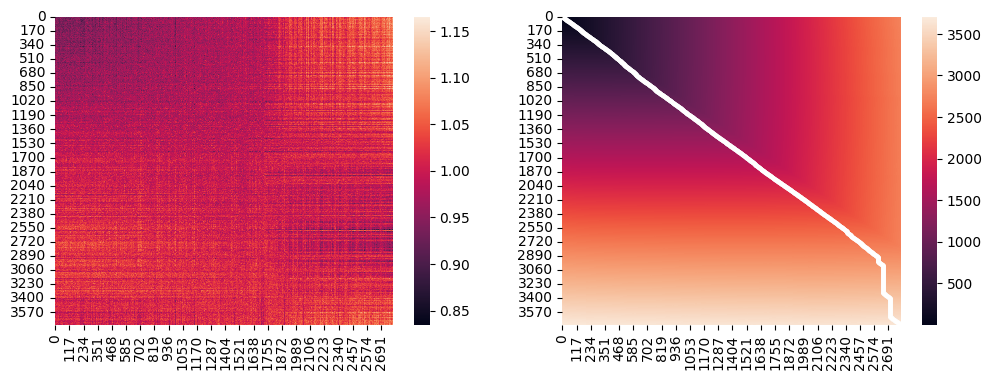

1 1
(3794, 14913) (3794, 14913)


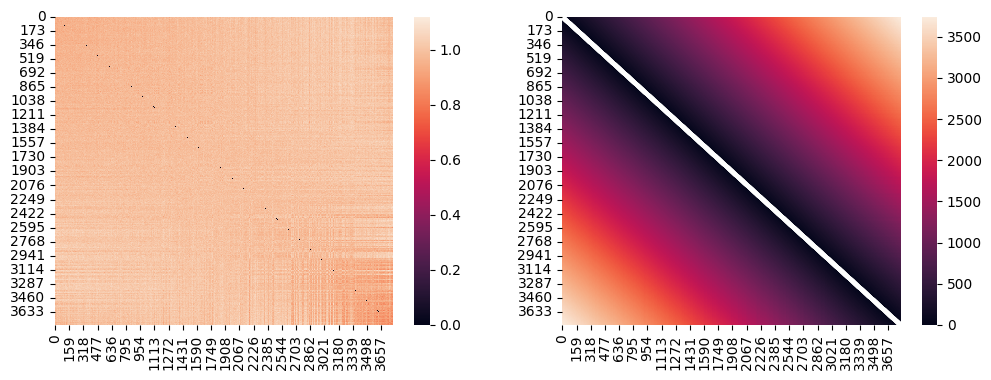

1 2
(6934, 13421) (3794, 13421)


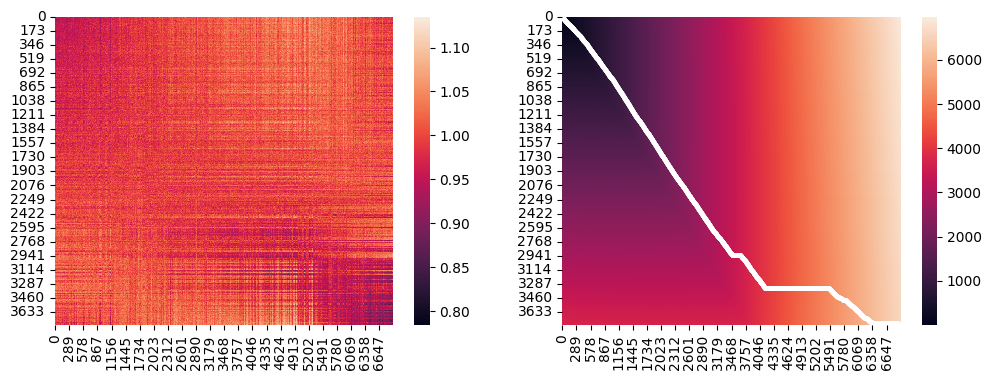

1 3
(2113, 14113) (3794, 14113)


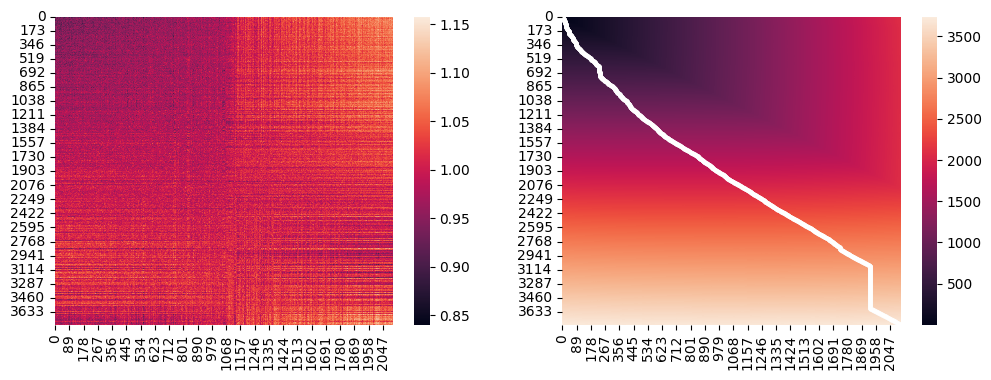

1 4
(3203, 14913) (3794, 14913)


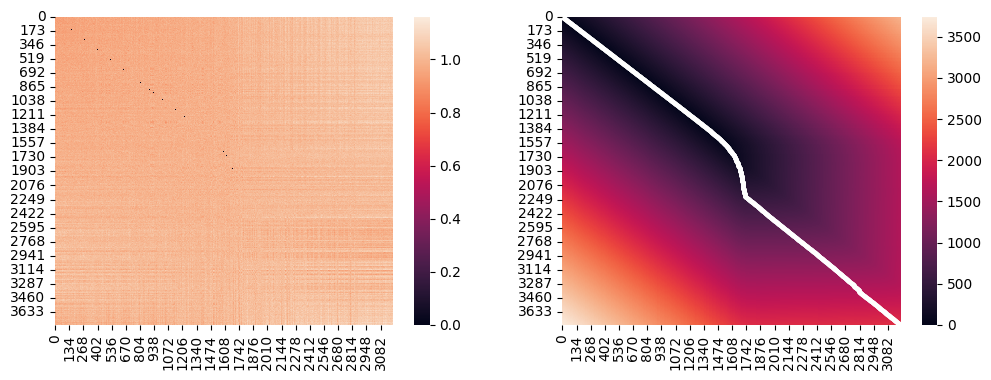

1 5
(2792, 13421) (3794, 13421)


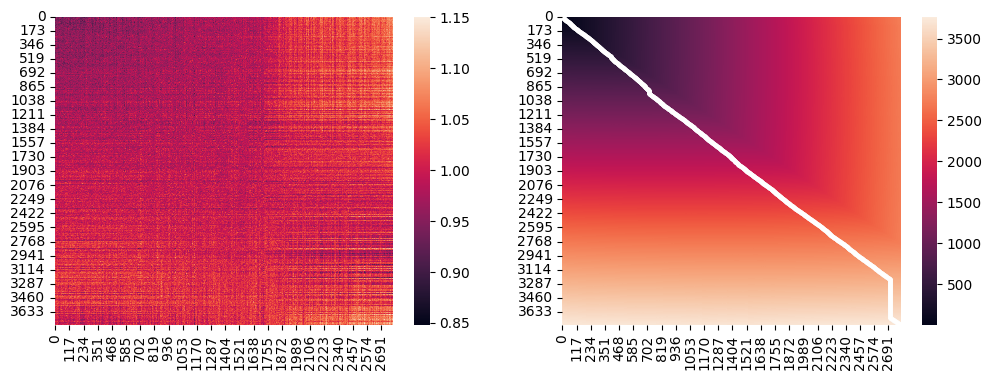

2 2
(6934, 14044) (6934, 14044)


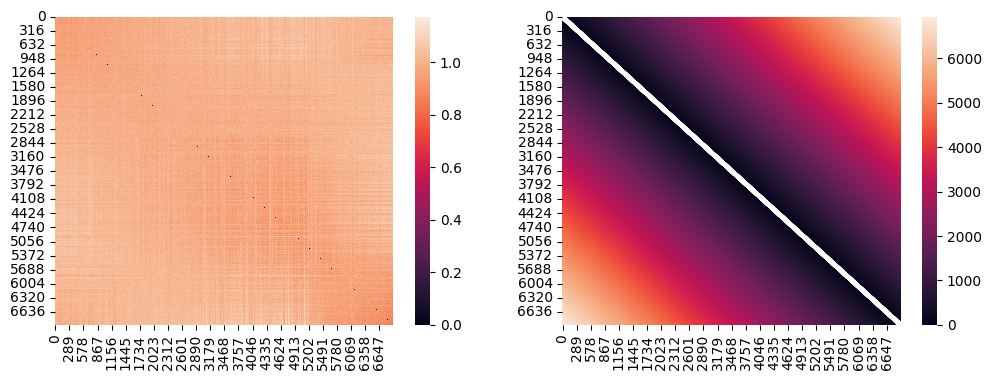

2 3
(2113, 13436) (6934, 13436)


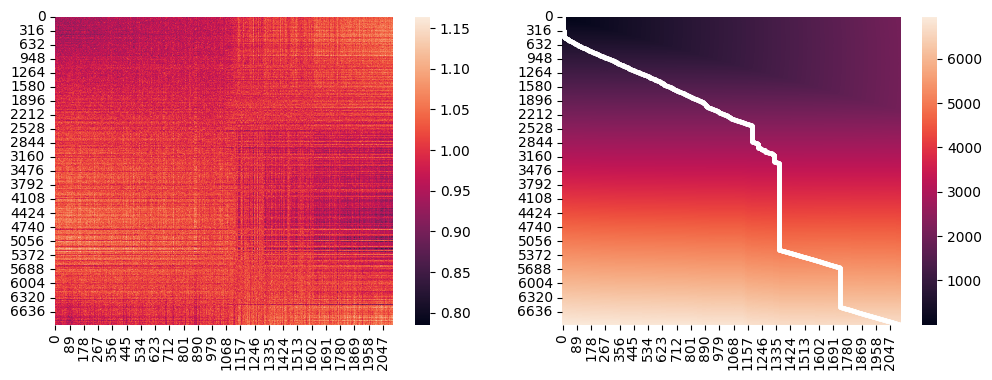

2 4
(3203, 13421) (6934, 13421)


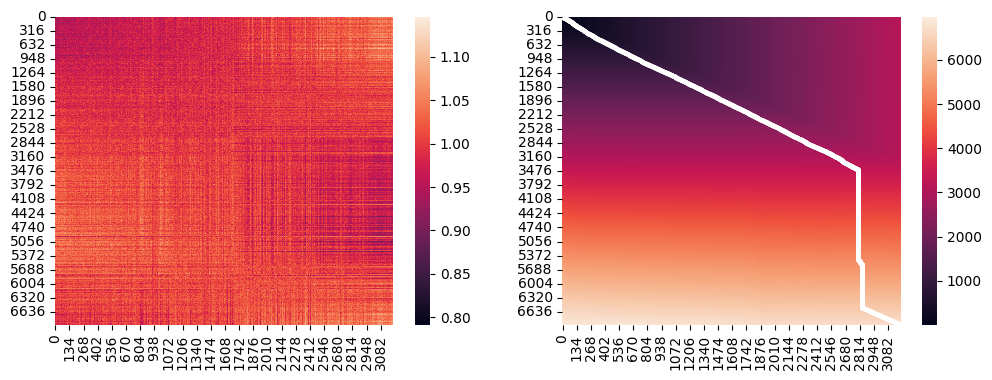

2 5
(2792, 14044) (6934, 14044)


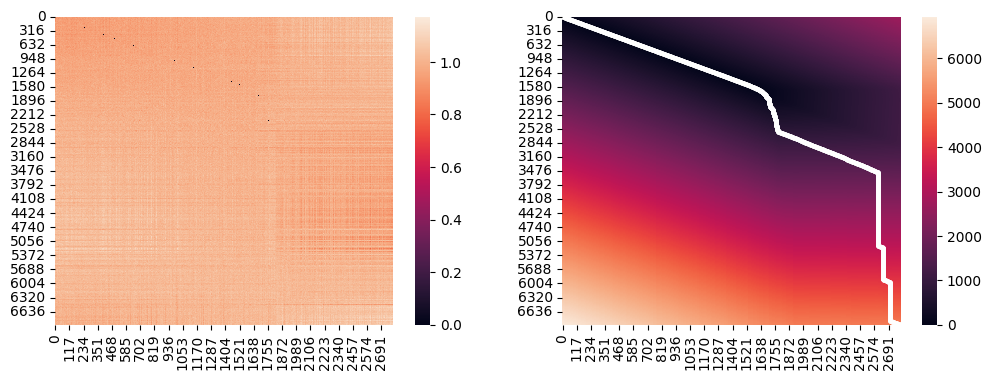

3 3
(2113, 14651) (2113, 14651)


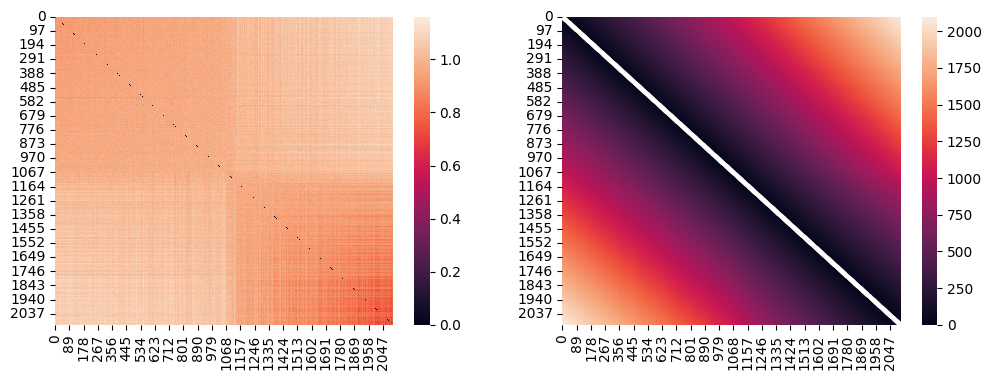

3 4
(3203, 14113) (2113, 14113)


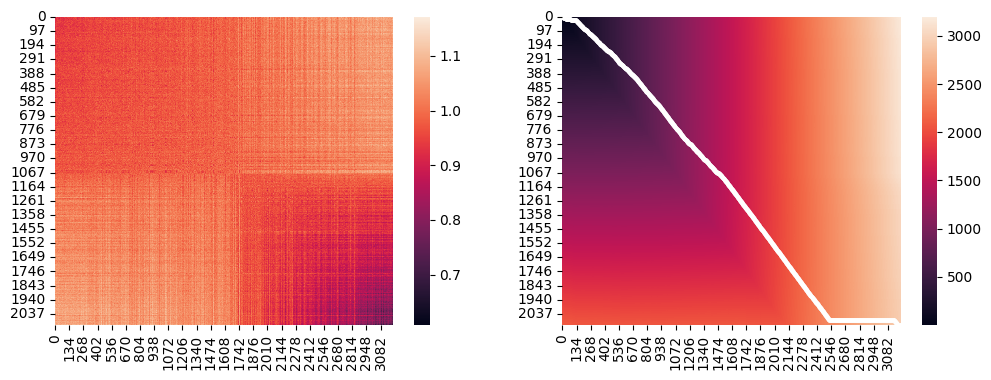

3 5
(2792, 13436) (2113, 13436)


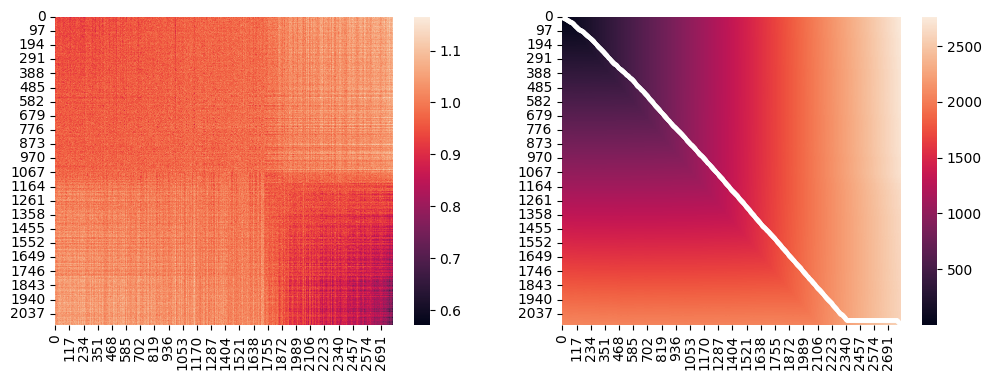

4 4
(3203, 14913) (3203, 14913)


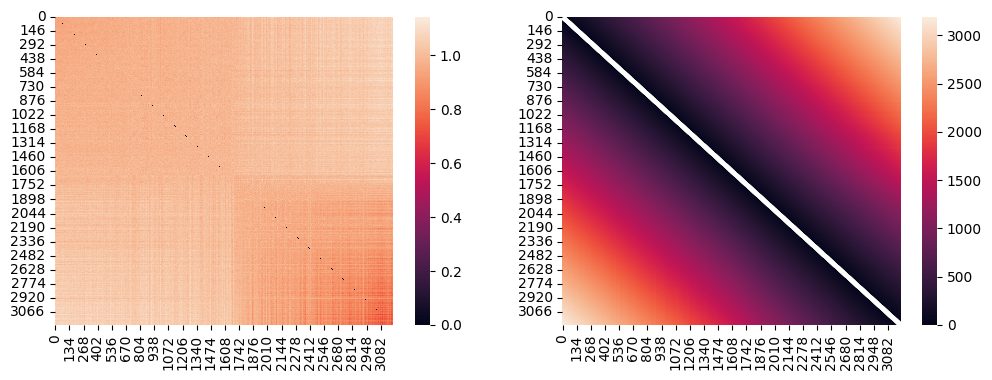

4 5
(2792, 13421) (3203, 13421)


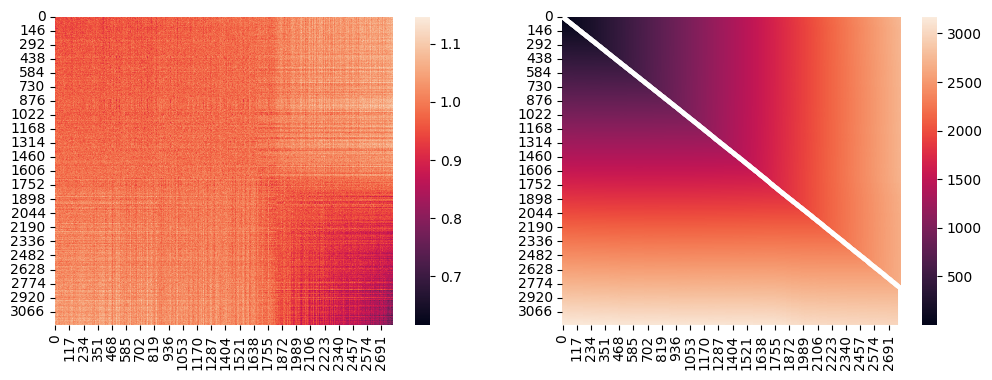

5 5
(2792, 14044) (2792, 14044)


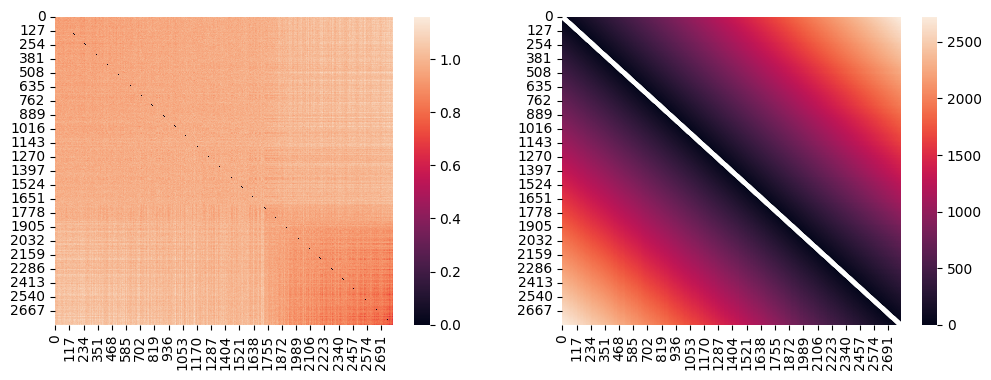

In [146]:
all_datasets = [rep1_mono, rep2_mono, rep3_mono, rep1_ery, rep2_ery, rep3_ery]
# list of lists with 6 zeroes each
results = [[0 for i in range(6)] for j in range(6)]

for i1 in range(len(all_datasets)):
    for j1 in range(i1, len(all_datasets)):
        print(f"{i1} {j1}")
        d1 = all_datasets[i1]
        d2 = all_datasets[j1]
        res = dynchro_wrapper(d1, d2)
        results[i1][j1] = res
        # fill it in the other triangle
        results[j1][i1] = res



In [148]:
all_dist = [[res[0].dist() for res in res1] for res1 in results]
all_dist_norm = [[res[0].dist_norm() for res in res1] for res1 in results]
all_dist_norm_path = [[res[0].dist_norm_path() for res in res1] for res1 in results]

<Axes: >

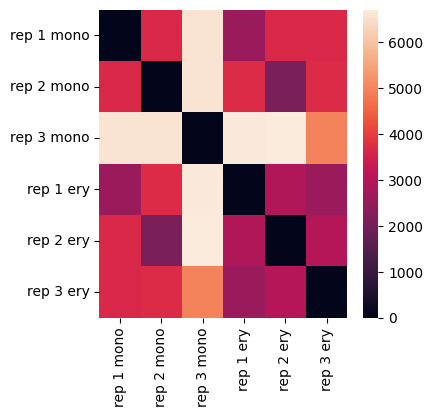

In [149]:
sns.heatmap(all_dist, xticklabels=labels, yticklabels =labels)


<Axes: >

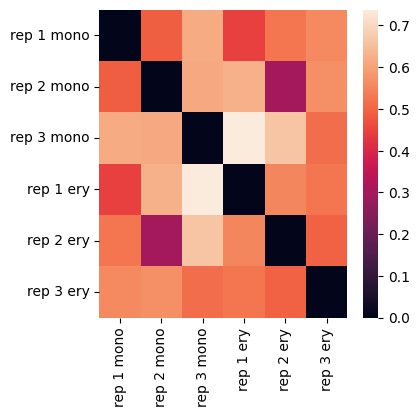

In [150]:
sns.heatmap(all_dist_norm, xticklabels=labels, yticklabels =labels)

<Axes: >

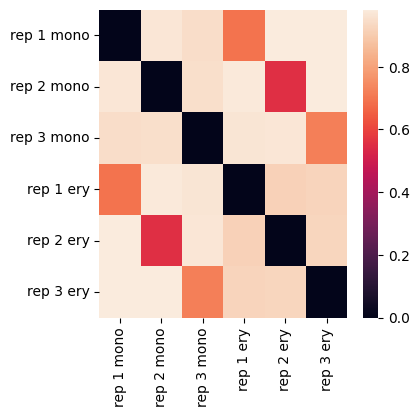

In [151]:
sns.heatmap(all_dist_norm_path, xticklabels=labels, yticklabels =labels)

## 2.3 HVGs

In [94]:
rep1

[AnnData object with n_obs × n_vars = 3721 × 14651
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Mono'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Mono_pseudotime', 'pseudocells_100_Mono_pseudotime_index', 'pseudocells_100_Mono_pseudotime_values'
     obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'tsne'
     varm: 'pseudocells_100_Mono',
 AnnData object with n_obs × n_vars = 2113 × 14651
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Ery'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Ery_pseudotime', 'pseudocells_100_Ery_pseudotime_index', 'pseudocells_100_Ery_pseudotime_values'
     obs

In [111]:
# calculate hvgs
sc.pp.highly_variable_genes(rep1, n_top_genes=1000)
sc.pp.highly_variable_genes(rep2, n_top_genes=1000)
sc.pp.highly_variable_genes(rep3, n_top_genes=1000)   

/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:208: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:208: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)
/home/louise/Work/dynchro/lib/python3.11/site-packages/scanpy/preprocessing/_highly_variable_genes.py:208: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)


In [112]:
rep1_hvg = rep1[:, rep1.var["highly_variable"] == True]
rep2_hvg = rep2[:, rep2.var["highly_variable"] == True]
rep3_hvg = rep3[:, rep3.var["highly_variable"] == True]

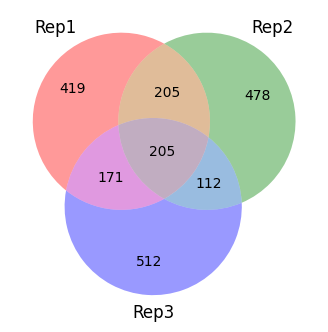

In [113]:
from matplotlib_venn import venn3

rep1_hvg_genes = set(rep1_hvg.var_names)
rep2_hvg_genes = set(rep2_hvg.var_names)
rep3_hvg_genes = set(rep3_hvg.var_names)

venn3([rep1_hvg_genes, rep2_hvg_genes, rep3_hvg_genes], set_labels = ["Rep1", "Rep2", "Rep3"])

In [115]:
hvg_genes = rep1_hvg_genes | rep2_hvg_genes | rep3_hvg_genes
len(hvg_genes)

2102

In [118]:
# select hvg_genes
rep1_mono_hvg = rep1_mono[:, rep1_mono.var_names.isin(hvg_genes)]
rep2_mono_hvg = rep2_mono[:, rep2_mono.var_names.isin(hvg_genes)]
rep3_mono_hvg = rep3_mono[:, rep3_mono.var_names.isin(hvg_genes)]

rep1_ery_hvg = rep1_ery[:, rep1_ery.var_names.isin(hvg_genes)]
rep2_ery_hvg = rep2_ery[:, rep2_ery.var_names.isin(hvg_genes)]
rep3_ery_hvg = rep3_ery[:, rep3_ery.var_names.isin(hvg_genes)]

In [119]:
rep1_mono_hvg, rep2_mono_hvg, rep3_mono_hvg

(View of AnnData object with n_obs × n_vars = 3721 × 2082
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Mono'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Mono_pseudotime', 'pseudocells_100_Mono_pseudotime_index', 'pseudocells_100_Mono_pseudotime_values'
     obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'tsne'
     varm: 'pseudocells_100_Mono',
 View of AnnData object with n_obs × n_vars = 3794 × 2075
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Mono'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Mono_pseudotime', 'pseudocells_100_Mono_pseudotime_index', 'pseudocells_100_Mono_pseudotim

In [120]:
rep1_ery_hvg, rep2_ery_hvg, rep3_ery_hvg

(View of AnnData object with n_obs × n_vars = 2113 × 2082
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Ery'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Ery_pseudotime', 'pseudocells_100_Ery_pseudotime_index', 'pseudocells_100_Ery_pseudotime_values'
     obsm: 'MAGIC_imputed_data', 'X_tsne', 'palantir_branch_probs', 'tsne'
     varm: 'pseudocells_100_Ery',
 View of AnnData object with n_obs × n_vars = 3203 × 2075
     obs: 'clusters', 'palantir_pseudotime', 'palantir_diff_potential', 'cell_type', 'milestones', 'pseudotime', 'Ery'
     uns: 'cell_type_colors', 'cluster_colors', 'clusters_colors', 'ct_colors', 'id', 'lineage_labels', 'palantir_branch_probs_cell_types', 'pseudocells', 'pseudocells_100_Ery_pseudotime', 'pseudocells_100_Ery_pseudotime_index', 'pseudocells_100_Ery_pseudotime_values'

## 2.4 dynchro on hvgs

0 0


(3721, 2082) (3721, 2082)


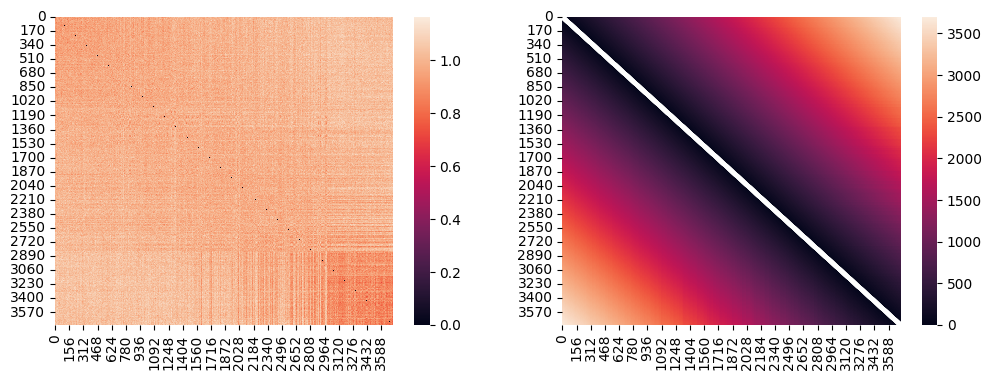

0 1
(3794, 2062) (3721, 2062)


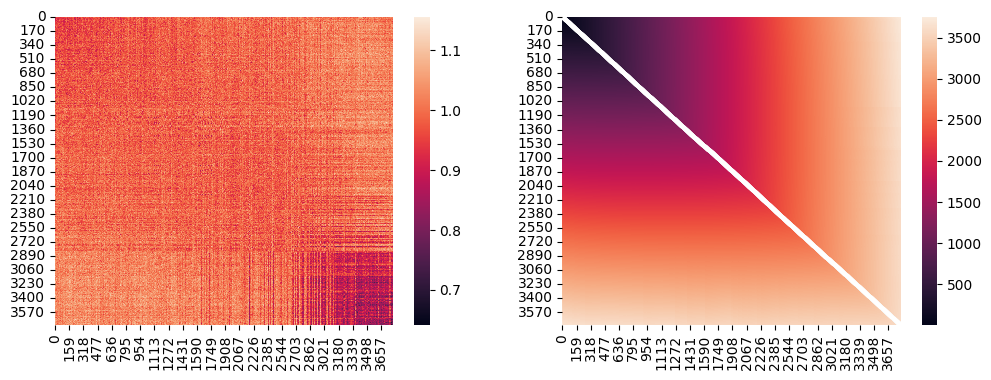

0 2
(6934, 2048) (3721, 2048)


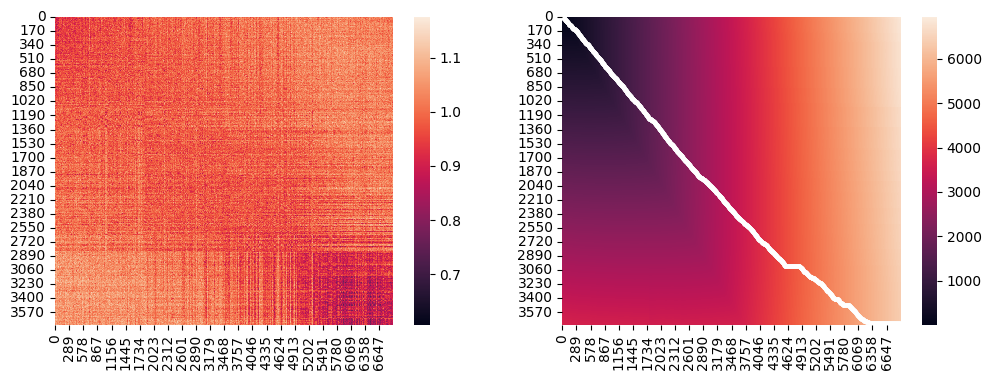

0 3
(2113, 2082) (3721, 2082)


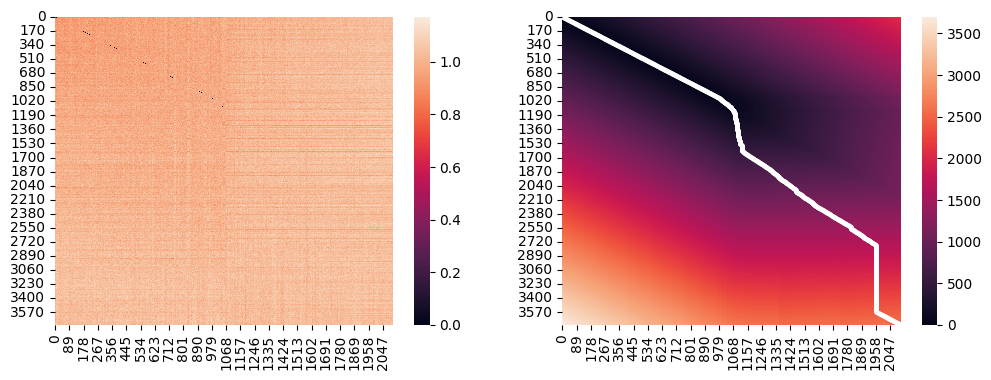

0 4
(3203, 2062) (3721, 2062)


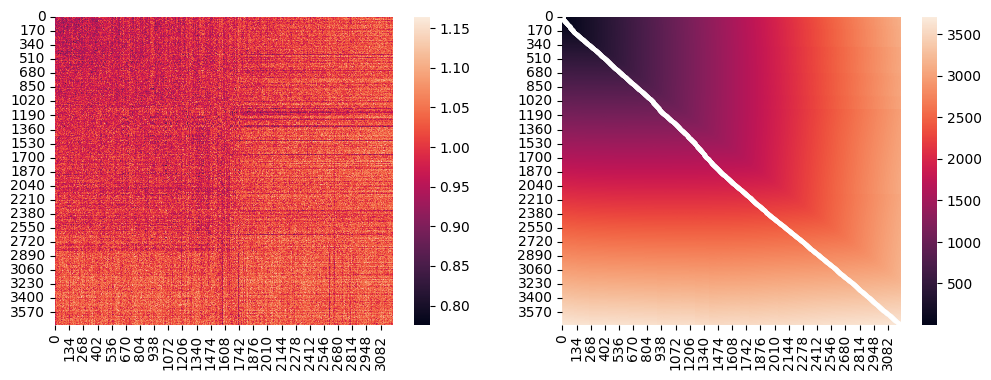

0 5
(2792, 2048) (3721, 2048)


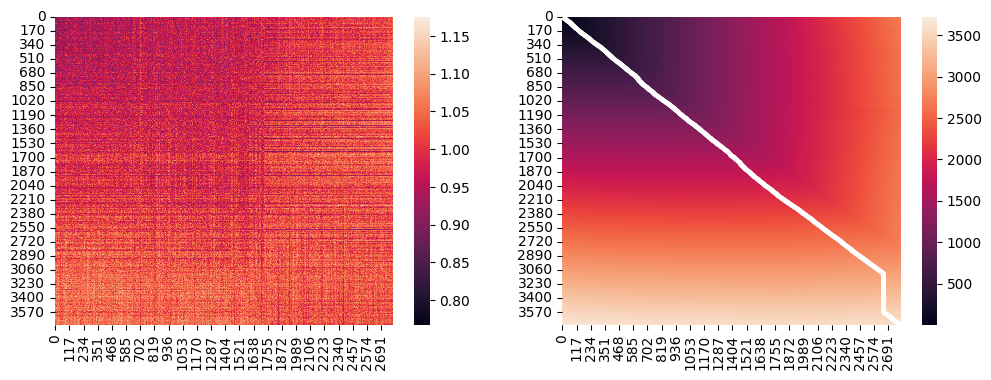

1 1
(3794, 2075) (3794, 2075)


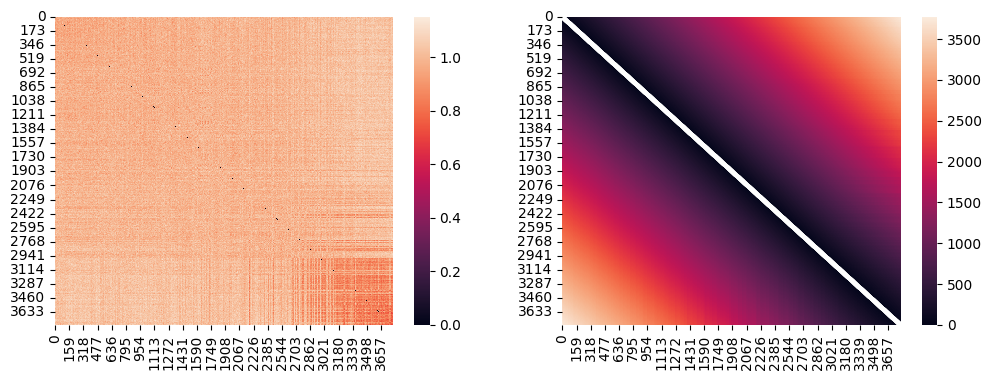

1 2
(6934, 2048) (3794, 2048)


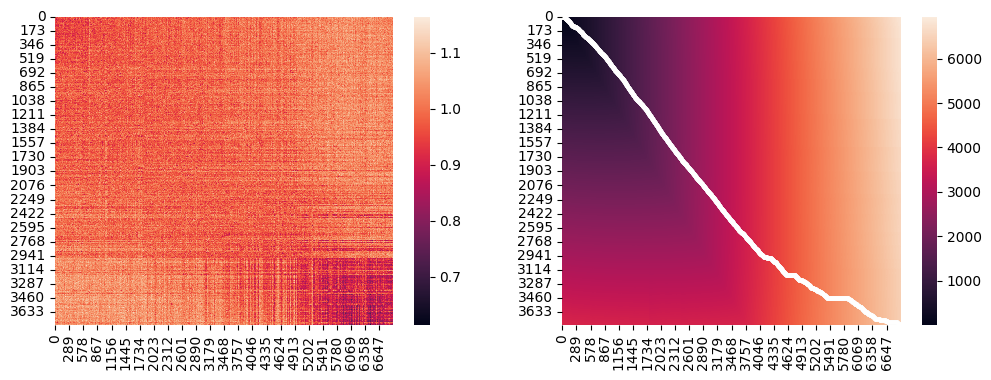

1 3
(2113, 2062) (3794, 2062)


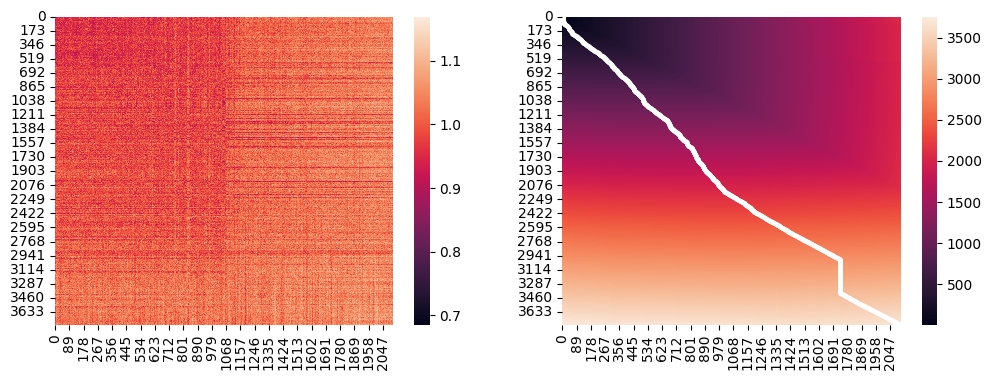

1 4
(3203, 2075) (3794, 2075)


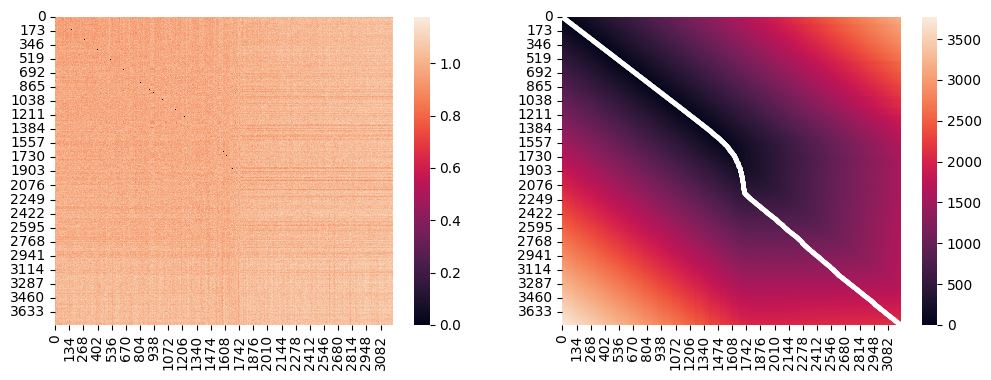

1 5
(2792, 2048) (3794, 2048)


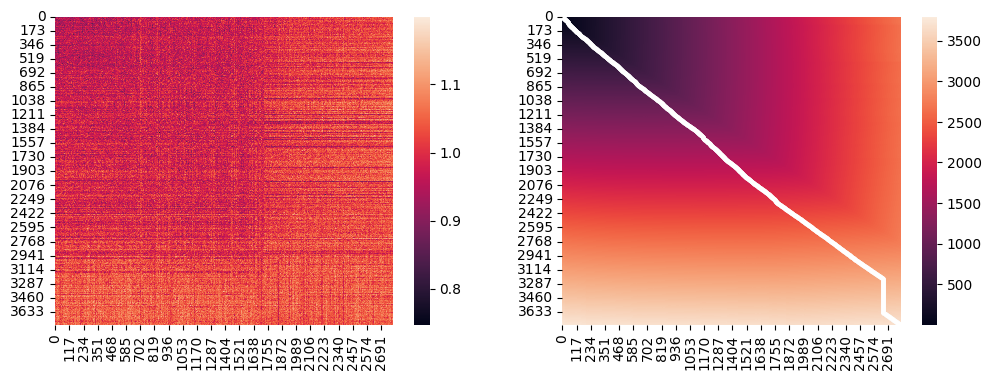

2 2
(6934, 2066) (6934, 2066)


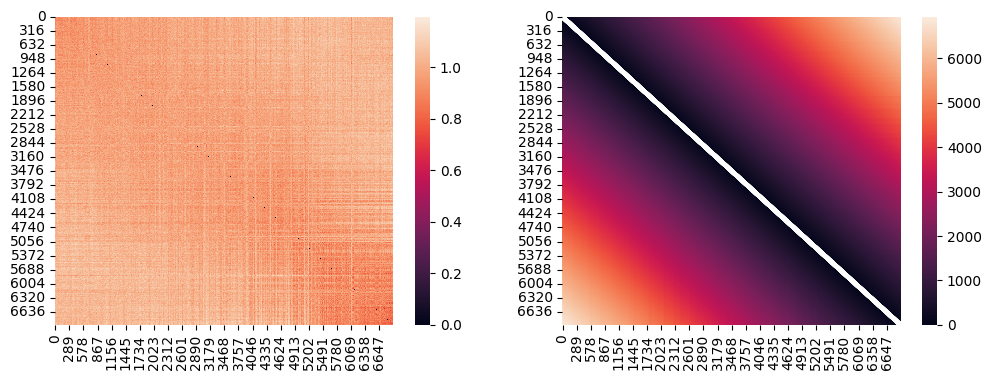

2 3
(2113, 2048) (6934, 2048)


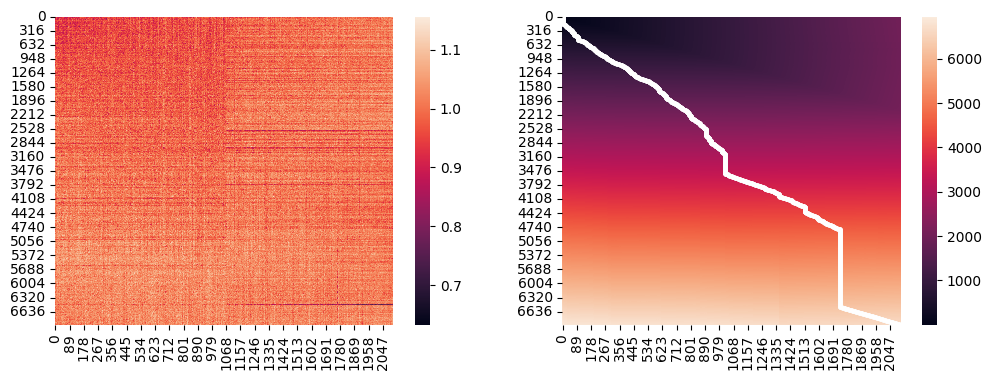

2 4
(3203, 2048) (6934, 2048)


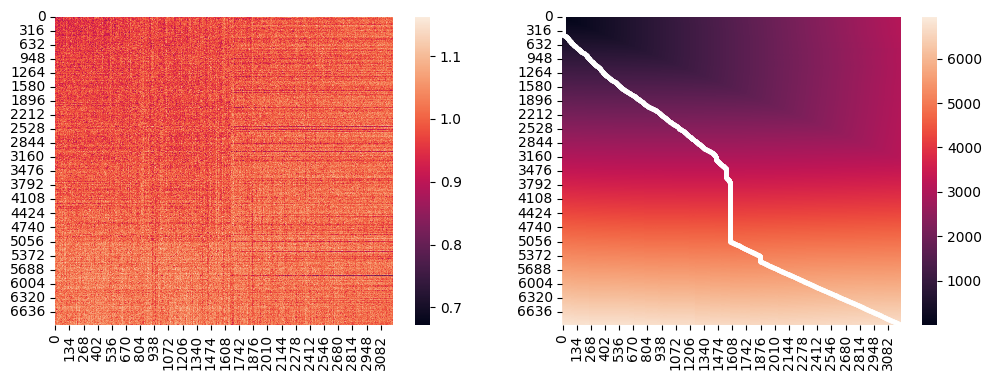

2 5
(2792, 2066) (6934, 2066)


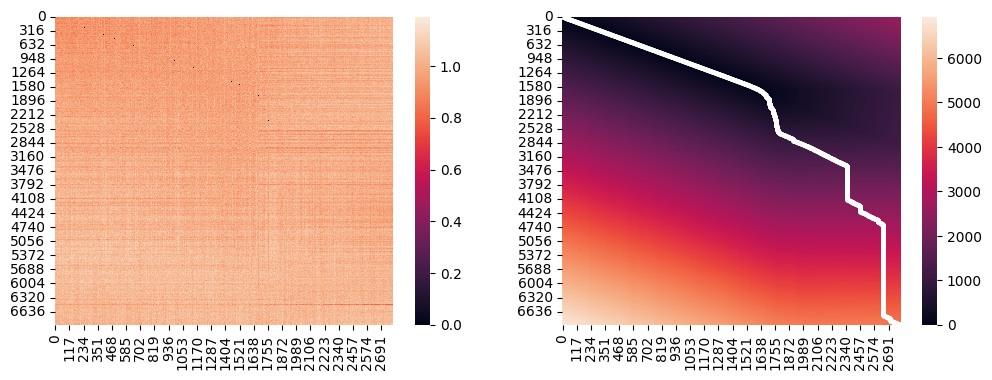

3 3
(2113, 2082) (2113, 2082)


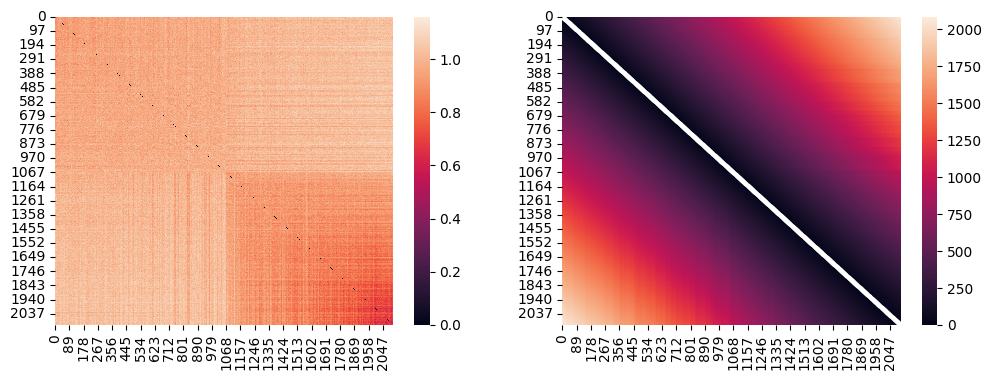

3 4
(3203, 2062) (2113, 2062)


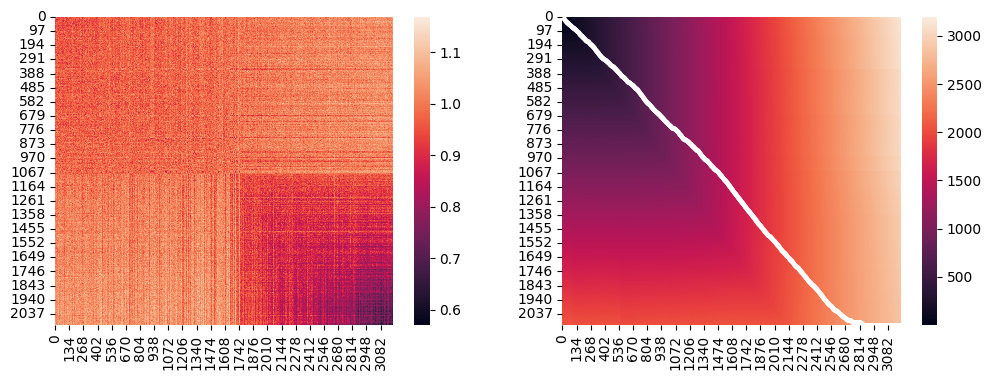

3 5
(2792, 2048) (2113, 2048)


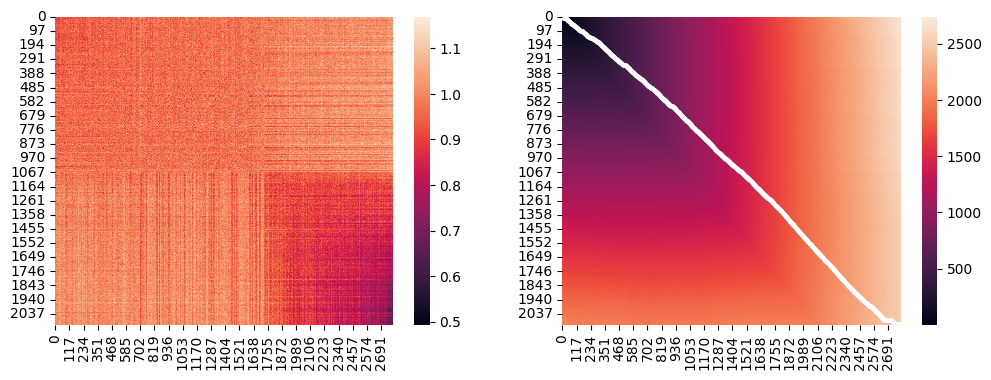

4 4
(3203, 2075) (3203, 2075)


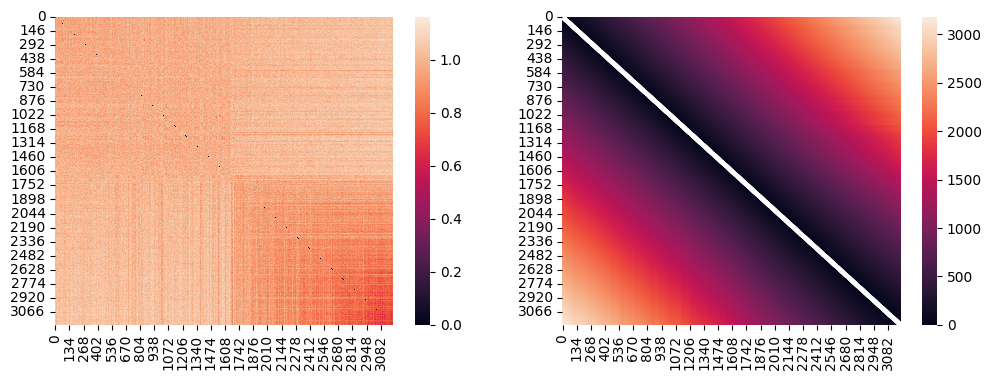

4 5
(2792, 2048) (3203, 2048)


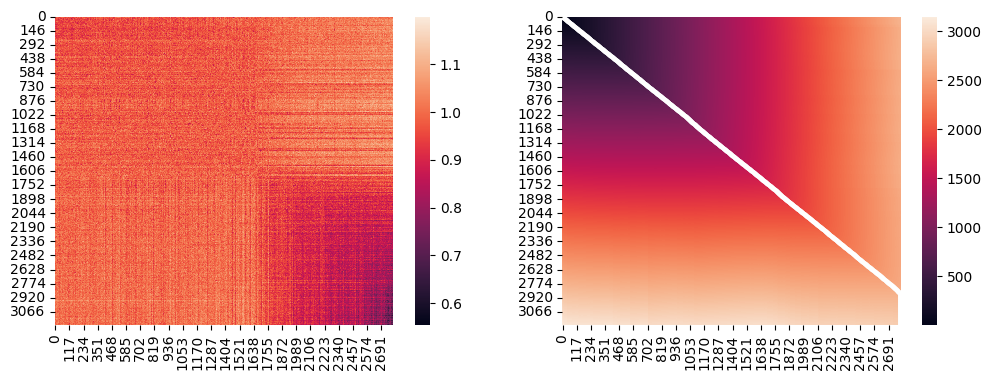

5 5
(2792, 2066) (2792, 2066)


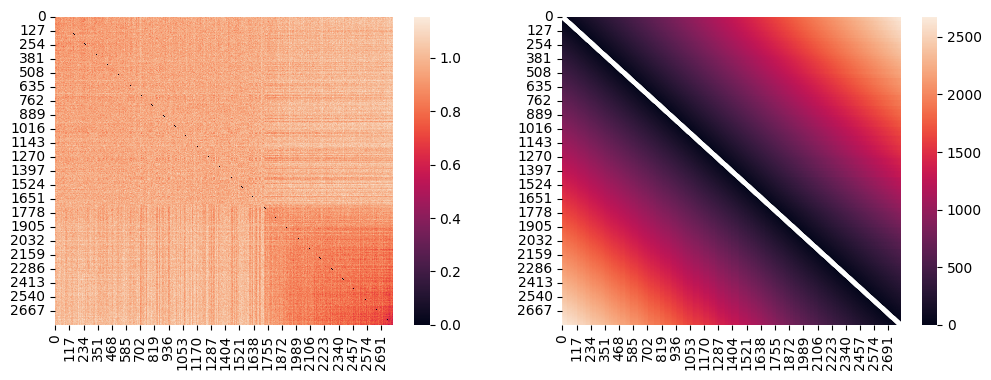

In [138]:
all_datasets_hvg = [rep1_mono_hvg, rep2_mono_hvg, rep3_mono_hvg, rep1_ery_hvg, rep2_ery_hvg, rep3_ery_hvg]
# list of lists with 6 zeroes each
results_hvg = [[0 for i in range(6)] for j in range(6)]

for i1 in range(len(all_datasets_hvg)):
    for j1 in range(i1, len(all_datasets_hvg)):
        print(f"{i1} {j1}")
        d1 = all_datasets_hvg[i1]
        d2 = all_datasets_hvg[j1]
        res = dynchro_wrapper(d1, d2)
        results_hvg[i1][j1] = res
        # fill it in the other triangle
        results_hvg[j1][i1] = res



In [139]:
labels = ["rep 1 mono", "rep 2 mono", "rep 3 mono", "rep 1 ery", "rep 2 ery", "rep 3 ery"]

In [140]:
results_hvg[0]

[[<__main__.DTWResult at 0x7ddf19eda6d0>],

In [142]:
hvg_dist = [[res[0].dist() for res in res1] for res1 in results_hvg]
hvg_dist_norm = [[res[0].dist_norm() for res in res1] for res1 in results_hvg]
hvg_dist_norm_path = [[res[0].dist_norm_path() for res in res1] for res1 in results_hvg]

<Axes: >

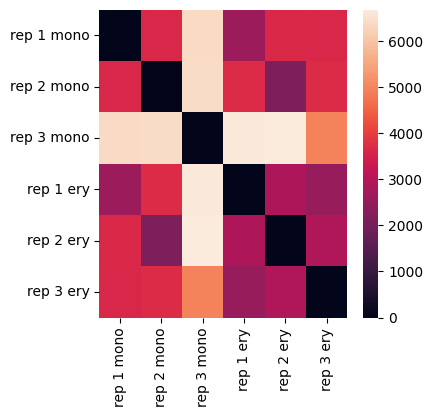

In [143]:
sns.heatmap(hvg_dist, xticklabels=labels, yticklabels=labels)

<Axes: >

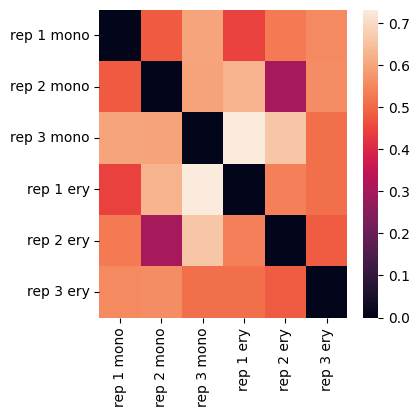

In [144]:
sns.heatmap(hvg_dist_norm, xticklabels=labels, yticklabels=labels)

<Axes: >

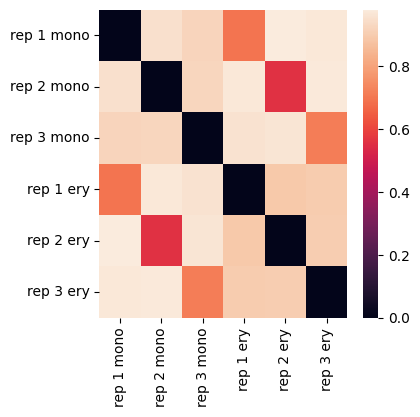

In [145]:
sns.heatmap(hvg_dist_norm_path, xticklabels=labels, yticklabels=labels)